# Bericht Immobilienrechner 


Angaben:

- Autor: Sean Corrigan, Rami Tarabishi
- Abgabedatum: 16.01.2023
- Challenge: cml1/3Db, Immobilienrechner
- Fachexperte: Fernando Benites
- Schule: FHNW
- Studiengang: BSc Data Science

## 1.) Einführung

Im Rahmen der Challenge haben wir einen Datensatz welcher von Fernando gestellt wurde untersucht. Unser Ziel war es, verschiedene Modelle zur Vorhersage des Immobilienpreises und zur Klassifizierung des Immobilientyps zu entwickeln. Zunächst haben wir eine explorative Datenanalyse durchgeführt, um die Daten zu verbessern und genau zu untersuchen. Anschließend haben wir ein einfaches lineares Regressionsmodell entwickelt, um den Immobilienpreis vorherzusagen und es so gut wie möglich optimiert. Im Laufe des Semesters haben wir die folgenden Modelle trainiert, optimiert und miteinander verglichen:


- ElasticNet
- KNN-Regressor
- DecisionTree-Regressor
- RandomForest-Regressor
- GraidentBoosting-Regressor

Wir haben auch den folgenden Klassifikator für die Vorhersage des Immobilientyps optimiert:


- RandomForest-Classifier


Am Ende haben wir eine API entwickelt, über die ein Nutzer Angaben zu seiner Immobilie eingeben kann und anschließend entweder den Preis oder den Immobilientyp als Vorhersage erhält.

## 2.) Importierte/verwendete Libraries

Wir haben unseren Code in einem Jupyter Notebook geschrieben, um einzelne Codeblöcke ausführen und die Daten immer wieder ansehen zu können. Wir haben die folgenden Bibliotheken verwendet:


- pandas: pandas ist eine Bibliothek zur Datenmanipulation und -analyse, die schnelle und flexible Datenstrukturen wie DataFrame und Series bereitstellt.
- NumPy: NumPy ist eine Bibliothek für die Programmiersprache Python, die Unterstützung für große, mehrdimensionale Arrays und Matrizen sowie eine große Sammlung von hochwertigen Mathematikfunktionen zur Verarbeitung dieser Arrays bereitstellt.
- Matplotlib: Matplotlib ist eine Plotting-Bibliothek für die Programmiersprache Python, die eine objektorientierte API zur Einbindung von Plots in Anwendungen mittels allgemeiner GUI-Werkzeugkits wie Tkinter, wxPython, Qt oder GTK bereitstellt.
- scikit-learn (sklearn): scikit-learn ist eine Bibliothek für maschinelles Lernen für die Programmiersprache Python, die effiziente Implementierungen einer Vielzahl von maschinellen Lernverfahren und Hilfsfunktionen zur Datenanalyse und -vorverarbeitung bereitstellt.
- statsmodels: statsmodels ist eine Bibliothek für statistische Modellierung und Hypothesentests in Python, die verschiedene statistische Verfahren und Modelle bereitstellt.
- pandas_profiling: pandas_profiling ist eine Bibliothek, die es ermöglicht, automatisch eine umfassende Profilanalyse von Datenframe zu erstellen, mit statistischen Informationen, Histogrammen, Korrelationsmatrizen und Warnungen vor potentiellen Problemen.
- SciPy: SciPy ist eine Bibliothek, die eine Vielzahl von hochwertigen und effizienten mathematischen Algorithmen und Funktionen für Anwendungen wie Optimierung, Integrale, Statistik und lineare Algebra bereitstellt.
- Seabron: Seaborn ist eine erweiterte Bibliothek für Datenvisualisierung, die sich besonders gut für die Erkundung und Darstellung von statistischen Modellen und Beziehungen in großen Datensätzen eignet. 

Wir haben innerhalb der Challenge keine eigenen Modelle entwickelt, sondern die in sklearn bereitgestellten modelle, trainiert, optimiert und miteinander verglichen.

In [8]:
# installing required libraries
!pip install numpy
!pip install pandas
!pip install sklearn
!pip install statsmodels
!pip install pandas_profiling 
!pip install pandoc
!pip install scipy
!pip install seaborn
!pip install matplotlib
!pip install nbconvert
!pip install webpdf

In [9]:
import pandas as pd
import numpy as np
from joblib import dump, load

from scipy import stats
from scipy.stats import skew

import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import FunctionTransformer, StandardScaler, PolynomialFeatures, MinMaxScaler, OneHotEncoder
from sklearn.feature_selection import SelectFromModel, SelectKBest, mutual_info_regression, RFECV, SequentialFeatureSelector
from sklearn.linear_model import ElasticNet, LogisticRegression, LinearRegression
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import mean_absolute_error, r2_score, mean_absolute_percentage_error, make_scorer
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.tree import DecisionTreeRegressor
from sklearn.feature_selection import f_regression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.utils.validation import check_is_fitted
from sklearn.ensemble import RandomForestRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.decomposition import PCA, NMF
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import GradientBoostingRegressor, HistGradientBoostingRegressor

from sklearn.metrics import classification_report

from pandas_profiling import ProfileReport

## 3.) Grundlagen / erhaltene Daten

Wir haben insgesamt zwei Datensätze erhalten:

- immo_data_202208_v2.csv: Trainings- und Validierungsdaten, mit denen wir unsere Modelle trainieren und validieren konnten.
- test_data-Kaggle-v0.11.csv: Daten für den Kaggle-Wettbewerb, in denen die Spalte "Preis" fehlte und von unseren Modellen vorhergesagt werden musste.

Die Daten wurden im August von unserem Fachexperten gesammelt (Quelle: Immoscount & Homegate). Sie wurden auch mit zusätzlichen geo-politischen Daten (z.B: Lärmbelastung, etc.) aus einem anderen Projekt angereichert, wobei die Zuweisung durch die kürzeste Distanz durch Latitude und Longitude erfolgte. Die Latitude und Longitude der gesammelten Daten wurden für "Standort" durch Openstreetmap bestimmt.

Alle Teams in den Challenges hatten die gleichen Grundlagen, konnten die Daten jedoch durch EDA und Datawrangling weiter verbessern. Es war auch möglich, über die Teams hinweg zusammenzuarbeiten, jedoch nur bei algorithmischen Fragen und Verständnisaspekten. Es war nicht erlaubt, zusammenhängende Code- oder Textblöcke von anderen Gruppen oder vom Internet zu kopieren.

Hier ein Ausschnitt aus den erhaltenen Trainings/Validations Datenset:

In [10]:
## import data
immo = pd.read_csv(
    './data/immo_data_202208_v2.csv',
    index_col=[0]
    )

## replace whitespaces in column names
immo.columns = immo.columns.str.replace(" ", "_")
immo.columns = immo.columns.str.replace(":", "")
immo['Type'] = immo.type

# look at data
immo.head(10)

c:\Users\rami0\AppData\Local\Programs\Python\Python310\lib\site-packages\IPython\core\interactiveshell.py:3457: DtypeWarning: Columns (3,4,5,6,11,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,45,46,47,49,50,107,110,114,115,116,119,120,121,124,125,126,128,131,132) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


,Unnamed_0.1,Municipality,Living_space,Plot_area,Floor_space,Availability,location,description,detailed_description,url,...,description_detailed,Floor_space,Number_of_floors,Volume,plz,Number_of_toilets,Gross_yield,Minimum_floor_space,space_cleaned,Type
0,0,Biberstein,100 m²,NaN,NaN,On request,"5023 Biberstein, AG","3.5 rooms, 100 m²«Luxuriöse Attika-Wohnung mit...",DescriptionLuxuriöse Attika-Wohnung direkt an ...,https://www.immoscout24.ch//en/d/penthouse-buy...,...,NaN,NaN,NaN,NaN,5023.0,NaN,NaN,NaN,NaN,penthouse
1,1,Biberstein,156 m²,222 m²,242 m²,On request,"Buhldenstrasse 8d5023 Biberstein, AG","4.5 rooms, 156 m²«Stilvolle Liegenschaft - ruh...",DescriptionStilvolle Liegenschaft an ruhiger L...,https://www.immoscout24.ch//en/d/terrace-house...,...,NaN,NaN,NaN,NaN,5023.0,NaN,NaN,NaN,NaN,terrace-house
2,2,NaN,NaN,NaN,NaN,NaN,"5022 Rombach, AG","2.5 rooms, 93 m²«Moderne, lichtdurchflutete At...","detail_responsive#description_title2,5 Zimmerw...",https://www.immoscout24.ch//en/d/penthouse-buy...,...,NaN,NaN,NaN,NaN,5022.0,NaN,NaN,NaN,NaN,penthouse
3,3,Biberstein,154 m²,370 m²,257 m²,On request,"Buhaldenstrasse 8A5023 Biberstein, AG","4.5 rooms, 154 m²«AgentSelly - Luxuriöses Eckh...",DescriptionDieses äusserst grosszügige Minergi...,https://www.immoscout24.ch//en/d/detached-hous...,...,NaN,NaN,NaN,NaN,5023.0,NaN,NaN,NaN,NaN,detached-house
4,4,Küttigen,142 m²,NaN,NaN,On request,"5022 Rombach, AG","4.5 rooms, 142 m²«MIT GARTENSITZPLATZ UND VIEL...",DescriptionAus ehemals zwei Wohnungen wurde ei...,https://www.immoscout24.ch//en/d/flat-buy-romb...,...,NaN,NaN,NaN,NaN,5022.0,NaN,NaN,NaN,NaN,flat
5,5,Erlinsbach (AG),190 m²,1063 m²,220 m²,On request,"Buchhalde 365018 Erlinsbach, AG","5.5 rooms, 190 m²«Modernes, grosszügiges Maiso...",DescriptionDer Blick in die Weite vermittelt R...,https://www.immoscout24.ch//en/d/detached-hous...,...,NaN,NaN,NaN,NaN,5018.0,NaN,NaN,NaN,NaN,detached-house
6,6,Biberstein,124 m²,200 m²,NaN,Immediately,"5023 Biberstein, AG","4.5 rooms, 124 m²«Kompakt, doch geräumiges 4½ ...",DescriptionZum Objekt:Kompakt und doch sehr ge...,https://www.immoscout24.ch//en/d/terrace-house...,...,NaN,NaN,NaN,NaN,5023.0,NaN,NaN,NaN,NaN,terrace-house
7,7,Aarau,NaN,NaN,NaN,On request,"5004 Aarau, AG",4.5 rooms«Preishit! Grossräumige Wohnung mitte...,DescriptionNaturnah und doch am Zentrum diese ...,https://www.immoscout24.ch//en/d/flat-buy-aara...,...,NaN,NaN,NaN,NaN,5004.0,NaN,NaN,NaN,NaN,flat
8,8,Aarau,75 m²,NaN,NaN,On request,"Siebenmatten 495032 Aarau Rohr, AG","3.5 rooms, 75 m²«Gepflegte 3.5 Zimmer Dachwohn...",DescriptionDie Überbauung Siebenmatten in Aara...,https://www.immoscout24.ch//en/d/flat-buy-aara...,...,NaN,NaN,NaN,NaN,5032.0,NaN,NaN,NaN,NaN,flat
9,9,Erlinsbach (AG),110 m²,2116 m²,NaN,On request,"5018 Erlinsbach, AG","4.5 rooms, 110 m²«Renovierte 4.5 Zimmer Terras...","DescriptionTreten Sie ein, in Ihr neues, liebe...",https://www.immoscout24.ch//en/d/stepped-house...,...,NaN,NaN,NaN,NaN,5018.0,NaN,NaN,NaN,NaN,stepped-house


Und hier ein Ausschnitt aus den erhaltenen Trainings/Validations Datenset:

In [11]:
## import data
kaggle_contest = pd.read_csv(
    './data/test_data-Kaggle-v0.11.csv',
    index_col=[0]
    )

## replace whitespaces in column names
kaggle_contest.columns = kaggle_contest.columns.str.replace(" ", "_")
kaggle_contest.columns = kaggle_contest.columns.str.replace(":", "")

# look at data
kaggle_contest.head(10)

c:\Users\rami0\AppData\Local\Programs\Python\Python310\lib\site-packages\IPython\core\interactiveshell.py:3457: DtypeWarning: Columns (3,4,5,6,11,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,45,46,48,49,104,111,112,115,116,117,120,121,122,124,127,128,130,131) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


,Unnamed_0.1,Municipality,Living_space,Plot_area,Floor_space,Availability,location,description,detailed_description,url,...,Floor_space,Number_of_floors,Volume,plz,Number_of_toilets,Gross_yield,Minimum_floor_space,space_cleaned,Type,Hall_height
0,0,Suhr,220 m²,733 m²,NaN,On request,"Galeggenweg 95034 Suhr, AG","6.5 rooms, 220 m²«Landhausvilla mit einzigarti...",DescriptionVilla lädt zum Träumen ein Wir ver...,https://www.immoscout24.ch//en/d/villa-buy-suh...,...,NaN,NaN,NaN,5034.0,NaN,NaN,NaN,220.0,NaN,NaN
1,1,Suhr,230 m²,702 m²,NaN,On request,"Hofstattmattenweg 195034 Suhr, AG","7.5 rooms, 230 m²«Grosszügiges Anwesen mit tra...","DescriptionLicht, Glas und Holz - ein freisteh...",https://www.immoscout24.ch//en/d/detached-hous...,...,NaN,NaN,NaN,5034.0,NaN,NaN,NaN,230.0,NaN,NaN
2,2,Biberstein,131 m²,NaN,NaN,On request,"Gheldweg 105023 Biberstein, AG","4.5 rooms, 131 m²«Terrassenhaus mit traumhafte...",DescriptionLage Das 4.5-Zimmer-Terrassenhaus ...,https://www.immoscout24.ch//en/d/stepped-house...,...,NaN,NaN,NaN,5023.0,NaN,NaN,NaN,131.0,NaN,NaN
3,3,Suhr,140 m²,206 m²,140 m²,Immediately,"Obere Dorfstrasse 275034 Suhr, AG","6.5 rooms, 140 m²«Mittelhaus in Suhr an attrak...",DescriptionReiheneinfamilienhaus (Mittelhaus) ...,https://www.immoscout24.ch//en/d/terrace-house...,...,NaN,NaN,NaN,5034.0,NaN,NaN,NaN,140.0,NaN,NaN
4,4,Biberstein,156 m²,222 m²,242 m²,On request,"Buhldenstrasse 8d5023 Biberstein, AG","4.5 rooms, 156 m²«Bezugsbereit - ruhige Lage u...",DescriptionStilvolle Liegenschaft an ruhiger L...,https://www.immoscout24.ch//en/d/terrace-house...,...,NaN,NaN,NaN,5023.0,NaN,NaN,NaN,156.0,NaN,NaN
5,5,Biberstein,154 m²,370 m²,257 m²,On request,"Buhaldenstrasse 8A5023 Biberstein, AG","4.5 rooms, 154 m²«AgentSelly - Luxuriöses Eckh...",DescriptionDieses äusserst grosszügige Minergi...,https://www.immoscout24.ch//en/d/detached-hous...,...,NaN,NaN,NaN,5023.0,NaN,NaN,NaN,154.0,NaN,NaN
6,6,Suhr,118 m²,NaN,NaN,On request,"Tramstrasse 645034 Suhr, AG","4.5 rooms, 118 m²«Wohnung mit grossem, gedeckt...",DescriptionWir verkaufen im Auftrag und nach V...,https://www.immoscout24.ch//en/d/flat-buy-suhr...,...,NaN,NaN,NaN,5034.0,NaN,NaN,NaN,118.0,NaN,NaN
7,7,Suhr,210 m²,NaN,NaN,On request,"Wiesenweg 11a5034 Suhr, AG","5.5 rooms, 210 m²«Ein gepflegter Wohntraum mit...","DescriptionSie suchen eine grosszügige, gepfle...",https://www.immoscout24.ch//en/d/flat-buy-suhr...,...,NaN,NaN,NaN,5034.0,NaN,NaN,NaN,210.0,NaN,NaN
8,8,Suhr,NaN,579 m²,NaN,On request,"Südallee5034 Suhr, AG",5.5 rooms«Charmantes 5-Zimmer Einfamilienhaus ...,DescriptionDieses gut unterhaltene Einfamilien...,https://www.immoscout24.ch//en/d/detached-hous...,...,NaN,NaN,NaN,5034.0,NaN,NaN,NaN,NaN,NaN,NaN
9,9,Suhr,190 m²,370 m²,NaN,Immediately,"5034 Suhr, AG","6 rooms, 190 m²«Einfamilienhaus mit gepflegtem...",DescriptionSehr schönes 6-Zimmer Einfamilienha...,https://www.immoscout24.ch//en/d/detached-hous...,...,NaN,NaN,NaN,5034.0,NaN,NaN,NaN,190.0,NaN,NaN


## 4.) Explorative Datenanalyse (EDA) / Datawrangling / Teilaufgabe 1

Nachdem wir die Daten in unser Notebook geladen haben, haben wir eine explorative Datenanalyse durchgeführt. Aufgrund dieser Analyse haben wir die Daten verbessert, um sie aussagekräftiger zu machen. Wir haben die Daten aufbereitet, um einen Pandas Profiling Report erstellen zu können, um einen guten Überblick über unsere Daten zu erhalten. Wir haben darauf geachtet, dass wir unsere Datawrangling-Operationen als Sklearn-Transformerklassen geschrieben haben. So konnten wir später eine Preprocessing-Pipeline erstellen, mit der wir unsere Trainings-/Validierungsdaten und unsere Testdaten für den Kaggle-Wettbewerb ohne großen Aufwand transformieren konnten.

Weiterhin haben wir uns auf die Behandlung von fehlenden Werten und die Umwandlung von kategorialen Variablen konzentriert (OneHotEncoding), um unsere Daten für das maschinelle Lernen vorzubereiten. Wir haben auch die Verteilung der Zielvariable untersucht und gegebenenfalls angepasst, um eine bessere Vorhersagegenauigkeit zu erreichen. Insgesamt war die EDA ein wichtiger Schritt, um unsere Daten aufzubereiten und für das maschinelle Lernen vorzubereiten.

### 4.0.) Spezifizieren von für das Modell wichtigen Features

In dem Dataframe, den wir erhalten haben, waren viele Features vorhanden, von denen viele für unser Modell nicht wichtig waren (zum Beispiel könnten bei einer kategorischen Variable mit sehr vielen unique values beim One-Hot-Encoding zu viele Features entstehen, was das Modell overfitten und das Trainieren des Modells verlangsamen würde). Deshalb haben wir eine Transformer-Klasse geschrieben, in der die für unser Modell wichtigen Features ausgewählt wurden.

Die folgenden Features haben wir ausgewählt:


- Categorical:
    - Type
    - Canton
    - Elevator
    - Garage
    - New
    - Wheelchair
    - Balcony
    - Terrace
    - Fireplace
    - Child
    - Swimming
    - Parking
    - Minergy
- Numerical:
    - Rooms_combined
    - Living_area
    - Plot_area
    - Floor
    - ForestDensityL
    - ForestDensityM
    - ForestDensityS
    - NoisePollutionRailwayL
    - NoisePollutionRailwayM
    - NoisePollutionRailwayS
    - NoisePollutionRoadL
    - NoisePollutionRoadM
    - NoisePollutionRoadS
    - PopulationDensityL
    - PopulationDensityM
    - PopulationDensityS
    - RiversAndLakesL
    - RiversAndLakesM
    - RiversAndLakesS
    - WorkplaceDensityL
    - WorkplaceDensityM
    - WorkplaceDensityS
    - DistanceToTrainStation
    - Gde_area_agriculture_percentage
    - Gde_area_forest_percentage
    - Gde_area_nonproductive_percentage
    - Gde_area_settlement_percentage
    - Gde_average_house_hold
    - Gde_empty_apartments
    - Gde_foreigners_percentage
    - Gde_new_homes_per_1000
    - Gde_politics_bdp
    - Gde_politics_cvp
    - Gde_politics_evp
    - Gde_politics_fdp
    - Gde_politics_glp
    - Gde_politics_gps
    - Gde_politics_pda
    - Gde_politics_rights
    - Gde_politics_sp
    - Gde_politics_svp
    - Gde_pop_per_km2
    - Gde_population
    - Gde_private_apartments
    - Gde_social_help_quota
    - Gde_tax
    - Gde_workers_sector1
    - Gde_workers_sector2
    - Gde_workers_sector3
    - Gde_workers_total
    - Land_area
    - Room_height
    - Last_refurbishment
    - Year_built
    - Volume
    - Gross_yield
    - Number_of_floors
    - Number_of_toilets

Diese Funktion haben wir als Sklearn-Transformer-Klasse geschrieben, da wir diese Transformationen auf unseren Trainings-/Validationsdaten sowie auf den Kaggle-Contest-Daten ausführen mussten.

In [12]:
# specify which features are categorical
categorical_features_kaggle = ['Type', 'canton', 'Elevator', 'Garage', 'New',
       'Wheelchair', 'Balcony', 'Terrace', 'Fireplace',
       'Child', 'Swimming', 'Parking']

# specify which features are numeric
numeric_features_kaggle  = ['rooms_combined', 'living_area', 'Plot_area', 'Floor', 'ForestDensityL',
       'ForestDensityM', 'ForestDensityS', 'NoisePollutionRailwayL',
       'NoisePollutionRailwayM', 'NoisePollutionRailwayS',
       'NoisePollutionRoadL', 'NoisePollutionRoadM', 'NoisePollutionRoadS',
       'PopulationDensityL', 'PopulationDensityM', 'PopulationDensityS',
       'RiversAndLakesL', 'RiversAndLakesM', 'RiversAndLakesS',
       'WorkplaceDensityL', 'WorkplaceDensityM', 'WorkplaceDensityS',
       'distanceToTrainStation', 'gde_area_agriculture_percentage',
       'gde_area_forest_percentage', 'gde_area_nonproductive_percentage',
       'gde_area_settlement_percentage', 'gde_average_house_hold',
       'gde_empty_apartments', 'gde_foreigners_percentage',
       'gde_new_homes_per_1000', 'gde_politics_bdp', 'gde_politics_cvp',
       'gde_politics_evp', 'gde_politics_fdp', 'gde_politics_glp',
       'gde_politics_gps', 'gde_politics_pda', 'gde_politics_rights',
       'gde_politics_sp', 'gde_politics_svp', 'gde_pop_per_km2',
       'gde_population', 'gde_private_apartments', 'gde_social_help_quota',
       'gde_tax', 'gde_workers_sector1', 'gde_workers_sector2',
       'gde_workers_sector3', 'gde_workers_total', 'Land_area', 
       'Last_refurbishment', 'Year_built',
       'Number_of_floors']

In [13]:
class FeaturePreselector(BaseEstimator, TransformerMixin):
     
    def __init__(self, numeric_features, categorical_features):
        self.numeric_features = numeric_features
        self.categorical_features = categorical_features
        
    def fit(self, X, y = None):
        return self

    def transform(self, X, y = None):
        # reduce dataframe to selected features
        X = pd.concat([X[numeric_features_kaggle], X[categorical_features_kaggle]], axis=1) 
        return X

### 4.1.) Price Column

 Als nächstes haben wir uns mit unserer Target Variable, dem Immobilienpreis, auseinandergesetzt. Dazu haben wir die Spalte "Price" mit der Spalte "Price_Cleaned" verglichen. Um diese vergleichen zu können, mussten wir die Spalte "Price" zunächst "cleanen", indem wir alle nicht-numerischen Zeichen entfernt und den Währungsumrechnungskurs von EUR zu CHF angepasst haben (1 EUR = 0.99 CHF). Dabei stellten wir fest, dass diejenigen Zeilen, in denen wir die Währung umgerechnet haben, sich von denen in der Spalte "Price_Cleaned" unterscheiden, da in dieser Spalte ein Umrechnungskurs von 1 verwendet wurde. Aus diesem Grund haben wir unsere selbst gereinigte Spalte "Price" verwendet, da sie die Währungen korrekt umgerechnet enthält. Da diese Transformationen nur auf unseren Trainings- und Validationsdaten ausgeführt werden mussten, haben wir diese nicht als Sklearn Transformer-Klasse geschrieben.

In [14]:
############################# clean price column ###########################

# clean up CHF values
for char in ["CHF", ".", ",", "—", "–", " "]:
    immo.price = immo.price.str.replace(char, "")
immo.price = immo.price.replace("Priceonrequest", np.nan)

# convert EUR to CHF with exchange course EUR --> CHF 0.99 (Date: 16.12.2022)
def EUR_to_CHF(s):
    exchange_course = 0.99 # EUR to CHF
    if s.startswith("EUR"):
        return float(s[3:]) * exchange_course
    else:
        return s

immo.price = immo.price.astype(str)
immo.price = immo.price.apply(EUR_to_CHF)

# convert rest of values to float
immo.price = immo.price.astype(float)


C:\Users\rami0\AppData\Local\Temp/ipykernel_17048/2805829031.py:5: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  immo.price = immo.price.str.replace(char, "")


### 4.2.) Droppen von diversen Rows

Nachdem wir unsere Target Variable "gecleaned" hatten, haben wir den Dataframe im Jupyter Notebook Variable Viewer manuell durchgesehen, um weitere Auffälligkeiten zu finden, die uns aufgefallen sind. Dabei haben wir folgende Dinge festgestellt:

- Spezifische Immobilientypen: Es gibt diverse Immobilientypen, die nur sehr selten vorkommen und die für unser Modell nicht relevant sind, da wir uns auf Wohnimmobilien beschränken wollen. Um ein Overfitting zu vermeiden, haben wir die Zeilen mit diesen Typen aus dem Dataframe entfernt. Spezifisch betraf es hier die Typen "Hobby room", "Granny Flat" und "Cellar Compartment".
- Überbauungen: Inserate von Überbauungen kamen häufig mehrfach vor und die Daten waren nicht gut strukturiert. Zum Beispiel waren mehrere Wohnungen in einem Inserat aufgeführt, wie z.B. "3.5/4.5/5.5-Zimmer-Wohnungen", wobei oft der Wert für Living_Area und Rooms nicht mit dem Preis übereingestimmt hat. Deshalb haben wir diese Inserate entfernt.
- Zu niedriger Preis: Einige Inserate hatten einen zu niedrigen Preis und machten aufgrund der Angaben keinen Sinn. Oft handelte es sich hierbei um Monatsmieten statt Kaufpreise. Um unser Modell nicht zu verwirren, haben wir alle Inserate mit einem Preis unter 10'000 CHF entfernt.
- Duplikate: Inserate waren häufig doppelt vorhanden. Wir haben alle Duplikate entfernt, indem wir die Spalte Description verwendet haben.
- Price NAN: Alle Inserate ohne angegebenen Preis haben wir entfernt.

Diese Transformationen haben wir nicht als Sklearn Transformer Klasse geschrieben, da wir sie nur auf unseren Trainings-/Validierungsdaten ausführen mussten.

In [15]:
# drop speacial types
immo = immo[immo.type.isin(['Hobby room', 'Granny flat', 'Cellar compartment']) == False]

# drop projects
immo = immo[immo.detailed_description.str.contains("lots|appartemens|wohnungen") == False]

# drop everything beneath 10'000CHF
immo = immo.query("price > 10000")

# drop all duplicates including the first occurence
immo = immo.drop_duplicates(subset=['description'],keep = False) 

# drop where price is nan
immo = immo[immo.price.isna() == False] 

### 4.3.) Informationen von der Description Column 

Wir haben uns anschließend weiter damit beschäftigt, unsere Daten zu verbessern. Dabei haben wir festgestellt, dass in der Spalte "Description" viele Informationen enthalten sind, die bereits in separate Spalten extrahiert wurden. Um diese Informationen besser zu nutzen, haben wir mehrere Transformer-Klassen erstellt. Diese Klassen ermöglichen es uns, unsere Trainings- und Validierungsdaten sowie unsere Testdaten entsprechend anzupassen. Wir haben die folgenden Informationen extrahiert:

- Living Area: Wir konnten die Wohnfläche aus der Beschreibung extrahieren. Nach einem Vergleich (Vergleich von Auge manuell, aufgrund der Zeilen, in welchen die beiden Values nicht übereingestimmt haben) mit der Spalte "Living_area_unified" haben wir festgestellt, dass die "Living_area_unified" plausibler war. Allerdings gab es dort diverse NAN-Werte, die wir mit den Werten aus der Beschreibung imputieren konnten.
- Räume: Auch die Anzahl der Räume konnten wir aus der Beschreibung extrahieren. Nach einem Vergleich (Vergleich von Auge manuell, aufgrund der Zeilen, in welchen die beiden Values nicht übereingestimmt haben) mit der Spalte "Rooms" haben wir festgestellt, dass unsere extrahierte Variable besser passte. Wir haben jedoch auch festgestellt, dass in der Spalte "Rooms" Werte vorhanden waren, wo wir NANs hatten. Deshalb haben wir dort, wo wir NANs in unserer extrahierten Variable hatten, diese mit den Werten aus der Spalte "Rooms" imputiert.

Wir haben keine weiteren Informationen aus der Beschreibung extrahiert oder weitere Analysen der Beschreibung durchgeführt.

In [16]:
########################################## Custom transformers ####################################
class DescriptionToString(BaseEstimator, TransformerMixin):
     
    def __init__(self):
        pass
        
    def fit(self, X, y = None):
        return self
        
    def transform(self, X, y = None):
        # convert description to string
        X['description'] = X.description.astype(str)
        
        return X

In [17]:
class ImproveLivinArea(BaseEstimator, TransformerMixin):

    def __init__(self):
        pass
        
    def fit(self, X, y = None):
        return self
    
    # function for merging columns
    def ColumnMerger2(self, row):
        if pd.isnull(row.Living_area_unified):
            return row.living_space_extracted
        else:
            return row.Living_area_unified

    def transform(self, X, y = None):

        # Extract Living Space from Description
        X['living_space_extracted'] = (
            X.description.str.findall('\d+\s?m')
            .apply(lambda x: x[0] if len(x)>0 else np.nan)
            .str.replace("m","")
            .str.replace(" ","")
            .astype(float)
            )

        # merge columns
        X['living_area'] = X.apply(self.ColumnMerger2, axis=1)
        
        return X

In [18]:
class ImproveRooms(BaseEstimator, TransformerMixin):
    # initializer 
    def __init__(self):
        pass
        
    def fit(self, X, y = None):
        return self

    # function for merging the columns
    def ColumnMerger(self, row):
        if row.rooms == row.rooms_extracted:
            return row.rooms
        if pd.isnull(row.rooms):
            return row.rooms_extracted
        if pd.isnull(row.rooms_extracted):
            return row.rooms
        else:
            return row.rooms_extracted

    def transform(self, X, y = None):

        X.rooms = X.rooms.astype(str)
        
        # clean up rooms column and convert to float
        X['rooms'] = (
            X.rooms.str.replace("rm", "")
            .str.replace(",", ".")
            .str.replace(" ", "")
            .astype(float)
        ) 

        # extract number of rooms from description
        X['rooms_extracted'] = (
            X.description.str.extract(r"([0-9]+[\.,]?[0-9]?)\s?\-?(Zimmer|room|camer|pièce)")[0]
            .str.replace(",",".")
            .str.replace("-", "")
            .astype(float)
        )

        # merge columns into new one
        X['rooms_combined'] = X.apply(self.ColumnMerger, axis=1)

        return X

### 4.4.) Cleanen des Type Features

In einem weiteren Schritt haben wir uns mit dem Feature "Type" beschäftigt und es "gecleaned". Dabei haben wir diverse Typen in gemeinsame Gruppen zusammengefasst, um später weniger einzelne Typen zu haben und das Modell dadurch weniger zu overfitten. Beispielsweise haben wir die Typen "Cellar-Compartment", "Single Room" und "Hobbyroom" alle als "Single Room" zusammengefasst.

Diese Transformation haben wir als Sklearn Transformer Klasse geschrieben, damit wir sie sowohl auf unseren Trainings- und Validierungsdaten als auch auf den Kaggle Contest Daten anwenden konnten.

In [19]:
class TypeCleaner(BaseEstimator, TransformerMixin):
    
    def __init__(self):
        pass
        
    def fit(self, X, y = None):
        return self

    def transform(self, X, y = None):

        # define mapping for replacement
        housing_types_map = {
            'Apartment': 'flat',
            'Bifamiliar house': 'detached-house',
            'Terrace flat': 'stepped-apartment',
            'Single house': 'detached-house',
            'Multi-family house': 'detached-house',
            'Duplex': 'duplex-maisonette',
            'Row house': 'semi-detached-house',
            'Attic flat': 'attic-flat',
            'Furnished dwelling': 'furnished-residential-property',
            'Villa': 'villa',
            'Loft': 'loft',
            'Studio': 'studio',
            'Bachelor flat': 'studio',
            'Roof flat': 'penthouse',
            'Farm house': 'farmhouse',
            'Castle': 'castle',
            'Terrace house': 'terrace-house',
            'Rustic house': 'rustico',
            'Rustico':'rustico',
            'Chalet': 'chalet',
            'Attic': 'attic-room',
            'Hobby room': 'single-room',
            'Granny flat': 'flat',
            'Cellar compartment': 'single-room',
            'Single Room': 'single-room',
        }

        # replace types
        X['Type'] = X['Type'].replace(housing_types_map)

        return X

### 4.5.) Location Feature in separate Features unterteilen

Als nächstes haben wir das Location Feature in einzelne Columns aufgesteilt. Wir haben dabei aber nur die folgenden Features erzeugt:


- canton
- zip
- city

Diese Transformation haben wir als Sklearn Transformer Klasse geschrieben, damit wir sie sowohl auf unseren Trainings- und Validierungsdaten als auch auf den Kaggle Contest Daten anwenden konnten.

In [20]:
class LocationExtractor(BaseEstimator, TransformerMixin):
     
    def __init__(self):
        pass
        
    def fit(self, X, y = None):
        return self

    def transform(self, X, y = None):
        # convert to string
        X['location_parsed'] = X.location_parsed.astype(str)

        # extract canton into separate column
        X['canton'] = (
            X.location_parsed.str.extract(r"Kanton:\s*(\w+)")[0]
            .astype(str)
            )

        # extract zip into separate column
        X['zip'] = (
            X.location_parsed.str.extract(r"plz:(.*)Stadt:")[0]
            .astype(str)
            )

        # extract city into separate column
        X['city'] = (
            X.location_parsed.str.extract(r"Stadt:(.*)Kanton:")[0]
            .astype(str)
            )
        
        return X

### 4.6.) Extrahieren von weiteren Features

Als nächstes haben wir aus dem "features" Feature weitere Features erzeugt, so dass wir diese später OneHotEncoden können. Die foglenden Fatrues haben wir des dem "features" Feature extrahiert:


- Elevator
- Garage
- New
- Wheelchair Access
- Balcony
- Terrace
- Fireplace
- Child Friendly
- Swimming Pool
- Parking
- Minergy

Diese Transformation haben wir als Sklearn Transformer Klasse geschrieben, damit wir sie sowohl auf unseren Trainings- und Validierungsdaten als auch auf den Kaggle Contest Daten anwenden konnten.


In [21]:
class HousingFeatureExtractor(BaseEstimator, TransformerMixin):
    
    def __init__(self):
        pass
        
    def fit(self, X, y = None):
        return self

    def FeatureExtractor(self, df, column):
        # function for extractig a feature
        tmp = df.copy()
        tmp[column] = tmp.features.str.contains(column)
        tmp[column] = tmp[column].replace("False", 0)
        tmp[column] = tmp[column].replace("True", 1)
        tmp[column] = tmp[column].astype(int)

        return tmp

    def transform(self, X, y = None):
        # fill na
        X['features'] = X.features.fillna('none')
        # define features to look for
        features = [
            'Elevator', 
            'Garage',
            'New', 
            'Wheelchair', 
            'Balcony', 
            'Terrace', 
            'Fireplace',
            'Child',
            'Swimming',
            'Parking',
            'Minergy'
            ]
        # extract features
        
        for feature in features:
            X = self.FeatureExtractor(df = X, column = feature)
        

        return X

### 4.7.) Strippen von Strings

In einem nächsten Schritt haben wir eine Transformer Klasse geschrieben in welcher wir die Numerischen Features von Alphabetischen und Charaktern gestrippt haben. Dies war speziell wichitg bei dem Floor Feature, welches häufig z.B: mit 4 Floor oder ähnlichem aufgeführt war.

Diese Transformation haben wir als Sklearn Transformer Klasse geschrieben, damit wir sie sowohl auf unseren Trainings- und Validierungsdaten als auch auf den Kaggle Contest Daten anwenden konnten.

In [22]:
class NumericStripper(BaseEstimator, TransformerMixin):
    
    def __init__(self, numeric_features):
        
        self.numeric_features = numeric_features

        self.floor_map= {
            "m2": "",
            " ": "",
            ",": "",
            "floor": "",
            "m²": "",
            "4. Basement": "-4",
            "3. Basement": "-3",
            "2. Basement": "-2",
            "1. Basement": "-1",
            "Ground floor": "0",
            "100. floor": "nan",
            "999. floor": "nan",
            "nan": "nan",
            "Ground": "nan",
            "2.Basement": "-2",
            "4.Basement": "-4",
            "1.Basement": "-1",
            "3.Basement": "-3",
            "GF": "0",
            "m": ""
        }
        
    def fit(self, X, y = None):
        return self

    def strip_to_numeric(self, value):
        # check if the value is a string
        if isinstance(value, str):
        # replace the whitespaces with a bottomline
            for key, replacement in self.floor_map.items():
                value = value.replace(key, replacement)
            if value.__contains__('. floor'):
                value = value.replace('. floor', "")
            if value.__contains__('%'):
                value = value.replace('%', "")
                value = float(value)/100
            return float(value)

        # if the value is not a string, return it as is
        return value

    def transform(self, X, y = None):
        # strip numeric features from strings
        X[self.numeric_features] = X[self.numeric_features].applymap(self.strip_to_numeric).astype(float)
        
        return X

### 4.8.) Cleanup pipeline

Die Oben beschrieben Transformer Klassen haben wir dann in einer "CleanUp Pipeline" zusammengefasst, so dass wir diese später in die Preprocessing Pipeline integrieren konnten.

In [23]:
################################################## Custom preprocessing pipeline #####################################
CleanupPipeline = Pipeline(steps=[
    ("DescriptionConverter", DescriptionToString()),
    ("ImproveLivinArea", ImproveLivinArea()),
    ("ImproveRooms", ImproveRooms()),
    ("TypeCleaner", TypeCleaner()),
    ("LocationExtractor", LocationExtractor()),
    ("HousingFeatureExtractor", HousingFeatureExtractor()),
    ("NumericStripper", NumericStripper(numeric_features_kaggle )),
    ("FeaturePreselector", FeaturePreselector(numeric_features_kaggle , categorical_features_kaggle )),
])

### 4.8.) Profiling Report von den relevanten Feaures

Wir haben einen Pandas Profiling Report auf den für uns relevanten Daten erstellt. Den Raport haben wir auf einem Subset von 1000 Datenpunkten erstellt. Mit dieser Anzahl von Daten benötigt der Raport nicht zu viel zeit bei der Erstellung benötigt.

Die folgenden Erkenntnisse haben wir aus den Reports erhalten:

- Categorical:
    - Terrace und Balcony haben eine Korrelation
    - Die Extracteten Features (Wheelchair, Swimming Pool, etc.) haben relativ viele 0s/NANs

- Numerical:
    - Wir haben generell viele Missing Values
    - Wir haben keine Negative Values was ein gutes Zeichen ist
    - Wir haben viele korrelierende Variablen, vor allem in den Gruppen, z.B: ForestDensityS korreliert mit ForestDensityM & ForestDensityL

Die beiden Reports sind als HTML Files im GitRepo gespeichert.

In [24]:
report_numeric = ProfileReport(pd.concat([immo.price, CleanupPipeline.fit_transform(X = immo)[numeric_features_kaggle[:15]]]).sample(1000))

In [25]:
report_numeric

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [26]:
report_numeric.to_file("Profile_report_Numeric.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [27]:
report_categroical = ProfileReport(CleanupPipeline.fit_transform(X = immo)[categorical_features_kaggle].sample(n=1000))

In [28]:
report_categroical

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [29]:
report_categroical.to_file("Profile_report_Categroical.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## 5.) Train/Test Split

Nachdem wir eine erste explorativ Datenanalyse durchgeführt und spezielle Transformer-Klassen für späteres Preprocessing erstellt haben, haben wir unsere Daten in Trainings- und Validierungsdaten unterteilt, indem wir einen Train/Test-Split im Verhältnis 20:80 durchgeführt haben.

In [30]:
# split target from features
X = immo.drop(columns=['price'])
y = immo.price

# train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2,random_state =12345)

## 6.) Preprocessing

Für das Preprocessing haben wir die Transformer-Klassen, die wir während der explorativen Datenanalyse für das Data Wrangling erstellt haben, in eine Clean-Up-Pipeline integriert. Anschließend haben wir zwei ColumnTransformer erstellt:

- Numerical_transformer, für numerische Merkmale, mit den folgenden Schritten:
    - Imputer: Imputation von fehlenden Werten mit dem jeweiligen Spaltenmedian. Da wir relativ viele Ausreißer im Datensatz hatten, haben wir den Median verwendet, um den Einfluss von Ausreißern zu reduzieren.
    - Scaler: Standard Scaler, um beim Gradientenabstieg schneller zu konvergieren.
- Categorical_transformer, für kategoriale Merkmale, mit den folgenden Schritten:
    - Imputer: Imputation mit "Missing".
    - OneHotEncoding: Standard One-Hot-Encoding für alle kategorialen Variablen.

Wir haben das Preprocessing in einer Pipeline zusammengefasst, damit wir die Trainings-, Test- und Kaggle-Wettbewerbsdaten einfach transformieren konnten.





In [31]:
#################################################### columntransformers ################################################
# create preprocessing pipeline for numeric data
numeric_transformer_kaggle = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy = 'median')),
    ('scaler', StandardScaler()),
    #("poly", PolynomialFeatures(degree=2))
    ])

numeric_transformer_kaggle_poly = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy = 'median')),
    ('scaler', StandardScaler()),
    ("poly", PolynomialFeatures(degree=2))
    ])

# create preprocessing pipeline for categorical data
categorical_transfromer_kaggle = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="constant", fill_value="missing")),
    ("onehot", OneHotEncoder(handle_unknown='ignore')),
    ])

# create preprocessing transformer
preprocessing_transformer_kaggle = ColumnTransformer([ 
    ("numeric", numeric_transformer_kaggle, numeric_features_kaggle ),
    ("categorical", categorical_transfromer_kaggle, categorical_features_kaggle )
    ],
    remainder='passthrough'
    )

# create preprocessing transformer
preprocessing_transformer_kaggle_poly = ColumnTransformer([ 
    ("numeric", numeric_transformer_kaggle_poly, numeric_features_kaggle ),
    ("categorical", categorical_transfromer_kaggle, categorical_features_kaggle )
    ],
    remainder='passthrough'
    )


#################################################### Preprocessing pipeline ################################################
preprocessing_pipeline = Pipeline(steps=[
    ("Cleaner", CleanupPipeline),
    ("ColumnTransformer", preprocessing_transformer_kaggle),
    ])

preprocessing_pipeline_poly = Pipeline(steps=[
    ("Cleaner", CleanupPipeline),
    ("ColumnTransformer", preprocessing_transformer_kaggle_poly),
    ])

In [32]:
# fit preprocessing pipeline
preprocessing_pipeline.fit(X_train)
preprocessing_pipeline_poly.fit(X_train)

# transform data
X_train_preprocessed = preprocessing_pipeline.transform(X_train)
X_test_preprocessed = preprocessing_pipeline.transform(X_test)
X_contest_preprocessed = preprocessing_pipeline.transform(kaggle_contest)

X_train_preprocessed_poly = preprocessing_pipeline_poly.transform(X_train)
X_test_preprocessed_poly = preprocessing_pipeline_poly.transform(X_test)
X_contest_preprocessed_poly = preprocessing_pipeline_poly.transform(kaggle_contest)

## 7.) Einfaches Lineares Regressionsmodell / Teilaufgabe 2.1
Für das einfache Regressionsmodell haben wir den LinearRegressor der sklearn Library verwendet und diesen auf der Variable Square meters trainiert. Wir haben als MAPE einen Wert von 95.27768461453303 erhalten, was relativ hoch ist. Deshalb haben wir die Residuals, sowie die Input und Target Varibale untersucht.


In [33]:
## Linear Regression pipeline
pipeline_Linear_Regression = Pipeline(steps = [
    #('selector',SelectKBest(mutual_info_regression)),
    ('model',LinearRegression())
    ])

## fit final model
pipeline_Linear_Regression.fit(
    X = X_train_preprocessed[:,1].reshape(-1,1),
    y = y_train
)

MAPE_Linear_Regression_train = 100 * mean_absolute_percentage_error(y_true = y_train, y_pred = pipeline_Linear_Regression.predict(X = X_train_preprocessed[:,1].reshape(-1,1)))
MAPE_Linear_Regression_test = 100 * mean_absolute_percentage_error(y_true = y_test, y_pred = pipeline_Linear_Regression.predict(X = X_test_preprocessed[:,1].reshape(-1,1)))

## output scores:
print(f"""
MAPE train: {MAPE_Linear_Regression_train}
MAPE test: {MAPE_Linear_Regression_test}
""")




MAPE train: 93.835999237628
MAPE test: 95.27768461453053



Bei genauerer Betrachtung (in unserem Fall mit diversen Residuen plots) sieht man, dass die Residuen nicht auf eine Normalverteilung passen, und das die Residuen auch nicht um 0 herum schwanken. Somit ist eigentlich klar ersichtlich, dass ein Lineares Regressionsmodel unsere Daten nicht gut beschreibt. Wir können, jedoch unsere Inputvariablen weiter untersuchen, um zu sehen, ob wir durch eine transformation unserer Inputvariablen eine Verbesserung des MAPE und der Verteilung der Residuen erreichen können. 

In [34]:
def ResidualAnalysisPlot(y_true, y_pred):
    # calculate residuals
    Residuals = y_true - y_pred
    Residuals = np.array(Residuals)

    # calculate standardizes reesiduals
    Residuals_stdz = (Residuals - np.mean(Residuals)) / np.std(Residuals)

    # titles for plots
    feature_title = 'Standardized Residuals'

    # Set up the layout for two plots side by side
    fig, axs = plt.subplots(2, 2, figsize=(12, 12))

    # Create the scatter plot
    density1 = axs[0,0].scatter(y_test, Residuals)
    axs[0,0].set_title('Residual Plot')
    axs[0,0].set_xlabel('y_true')
    axs[0,0].set_ylabel('Residuals')

    # Create the QQ plot
    density2 = stats.probplot(Residuals_stdz, plot=axs[0,1])
    axs[0,1].set_xlabel('normal Distribution')
    axs[0,1].set_ylabel(feature_title)

    # Create the density plot
    density1 = axs[1,0].hist(Residuals_stdz, bins=50, density=True)
    axs[1,0].set_title('Distribution')
    axs[1,0].set_xlabel(feature_title)
    axs[1,0].set_ylabel('Frequency')

    # Create the density plot 
    density2 = sns.kdeplot(Residuals_stdz)
    axs[1,1].set_title('Distribution')
    axs[1,1].set_xlabel(feature_title)
    axs[1,1].set_ylabel('Frequency')

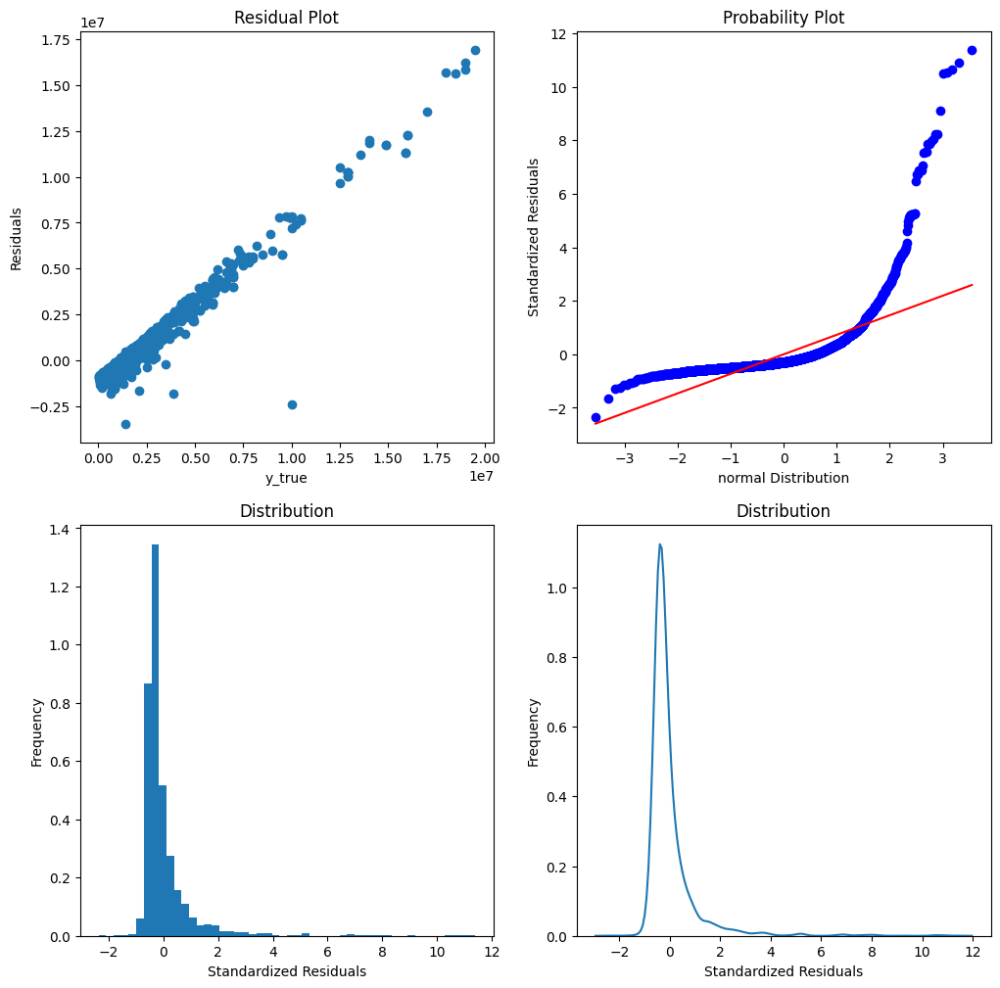

In [35]:
ResidualAnalysisPlot(
    y_true = y_test,
    y_pred = pipeline_Linear_Regression.predict(X = X_test_preprocessed[:,1].reshape(-1,1))
)

Als erstes haben wir unsere Inputvariable untersucht, ob wir diese durch eine Transformation besser auf deine Normalverteilung bringen können. Anhand der unten gezeigten Plots ist zu erkennen, dass die Verteilung der Values der Target Variable mit einer Log Transformation verbessert werden kann.

In [36]:
def TransformationPlot(feature_old, feature_title):
    feature_sqrt_transformed = np.sqrt(feature_old)
    feature_log_transformed = np.log(feature_old)
    feature_log10_transformed = np.log10(feature_old)
    feature_inverse_transformed = 1/(feature_old)

    # Set up the layout for two plots side by side
    fig, axs = plt.subplots(2, 5, figsize=(30, 12))

    # Create the Q-Q plot
    density1 = stats.probplot(feature_old, plot=axs[0,0])
    axs[0,0].set_xlabel(feature_title)
    axs[0,0].set_ylabel('Frequency')

    # Create the Q-Q plot for sqrt transformed
    density2 = stats.probplot(feature_sqrt_transformed, plot=axs[0,1])
    axs[0,1].set_xlabel(f"sqrt({feature_title})")
    axs[0,1].set_ylabel('Frequency')

    # Create the Q-Q plot for log transformed
    density2 = stats.probplot(feature_log_transformed, plot=axs[0,2])
    axs[0,2].set_xlabel(f"log({feature_title})")
    axs[0,2].set_ylabel('Frequency')

    # Create the Q-Q plot for log10 transformed
    density2 = stats.probplot(feature_log10_transformed, plot=axs[0,3])
    axs[0,3].set_xlabel(f"log10({feature_title})")
    axs[0,3].set_ylabel('Frequency')

    # Create the Q-Q plot for inverse transformed
    density2 = stats.probplot(feature_inverse_transformed, plot=axs[0,4])
    axs[0,4].set_xlabel(f"inverse({feature_title})")
    axs[0,4].set_ylabel('Frequency')

    # Create the density plot
    density1 = axs[1,0].hist(feature_old, bins=50, density=True)
    axs[1,0].set_xlabel(feature_title)
    axs[1,0].set_ylabel('Frequency')

    # Create the density plot for sqrt transformed
    density2 = axs[1,1].hist(feature_sqrt_transformed, bins=50, density=True)
    axs[1,1].set_xlabel(f"sqrt({feature_title})")
    axs[1,1].set_ylabel('Frequency')

    # Create the density plot for log transformed
    density2 = axs[1,2].hist(feature_log_transformed, bins=50, density=True)
    axs[1,2].set_xlabel(f"log({feature_title})")
    axs[1,2].set_ylabel('Frequency')

    # Create the density plot for log10 transformed
    density2 = axs[1,3].hist(feature_log10_transformed, bins=50, density=True)
    axs[1,3].set_xlabel(f"log10({feature_title})")
    axs[1,3].set_ylabel('Frequency')

    # Create the density plot for inverse transformed
    density2 = axs[1,4].hist(feature_inverse_transformed, bins=50, density=True)
    axs[1,4].set_xlabel(f"inverse({feature_title})")
    axs[1,4].set_ylabel('Frequency')

    print(
    f"""
    Transformations for better skewness of feature variable '{feature_title}'
    -------------
    skew {feature_title}:           {skew(feature_old)}
    skew sqrt({feature_title}):     {skew(feature_sqrt_transformed)}
    skew log({feature_title}):      {skew(feature_log_transformed)}
    skew log10({feature_title}):    {skew(feature_log10_transformed)}
    skew inverse({feature_title}):  {skew(feature_inverse_transformed)}
    """
    )


    Transformations for better skewness of feature variable 'price'
    -------------
    skew price:           8.23741865022083
    skew sqrt(price):     2.748049342435257
    skew log(price):      0.3750563986012194
    skew log10(price):    0.37505639860121454
    skew inverse(price):  14.060860033458695
    


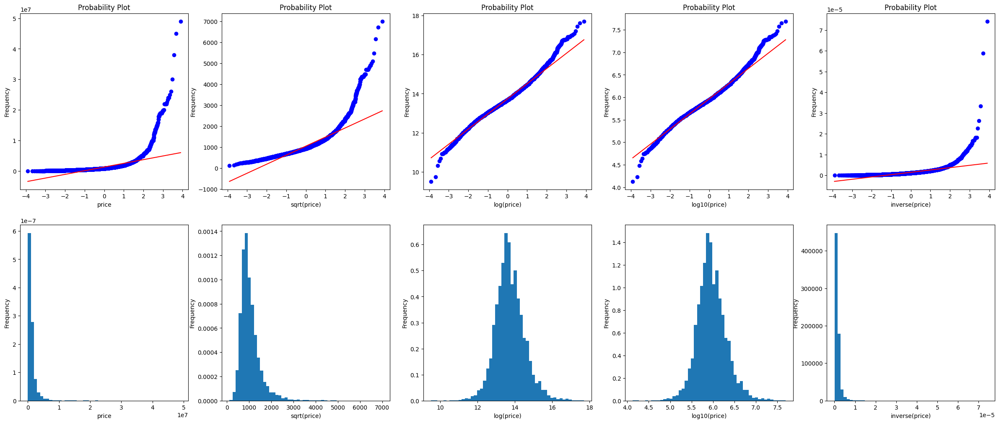

In [37]:
TransformationPlot(
    feature_old = y_train,
    feature_title = 'price'
)

Auch bei dem Input Feature square Meters kann eine Log transformation helfen, die Daten besser auf eine Normalverteilung zu bringen.


    Transformations for better skewness of feature variable 'square meters'
    -------------
    skew square meters:           76.58172682050093
    skew sqrt(square meters):     4.888471115751927
    skew log(square meters):      -1.3295427591355913
    skew log10(square meters):    -1.3295427591355913
    skew inverse(square meters):  6.85383197659027
    


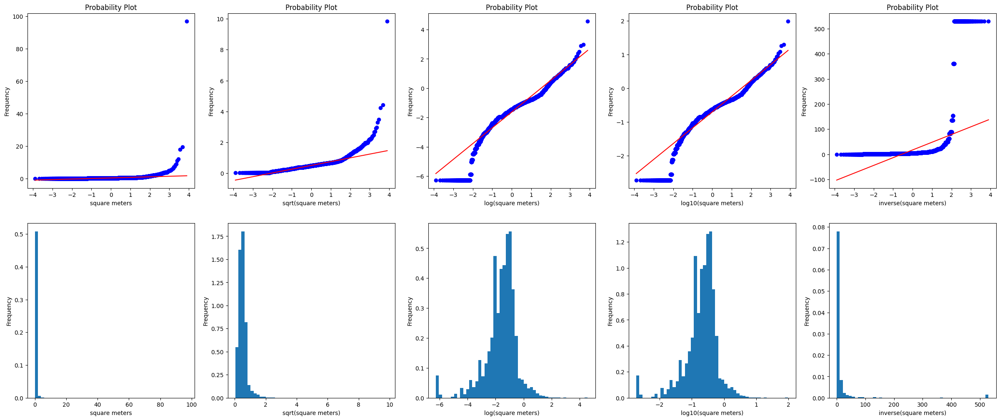

In [38]:
TransformationPlot(
    feature_old = np.abs(X_train_preprocessed[:,1]),
    feature_title = 'square meters'
)

Wenn die Variablen und die Transformierten Variablen gegeneinander geplottet werden, so kann man erkennen, dass keine wirkliche lineare Beziehung zwischen den beiden Variablen besteht. Jedoch kann eine leichte Verbesserung erzielt werden durch die Log Transformation von der Varibale square meters.

Text(0, 0.5, 'Price')

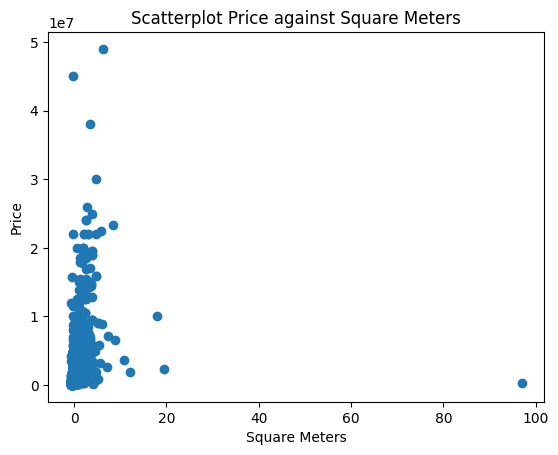

In [39]:
plt.scatter(X_train_preprocessed[:,1],y_train)
plt.title('Scatterplot Price against Square Meters')
plt.xlabel('Square Meters')
plt.ylabel('Price')

Text(0, 0.5, 'Price')

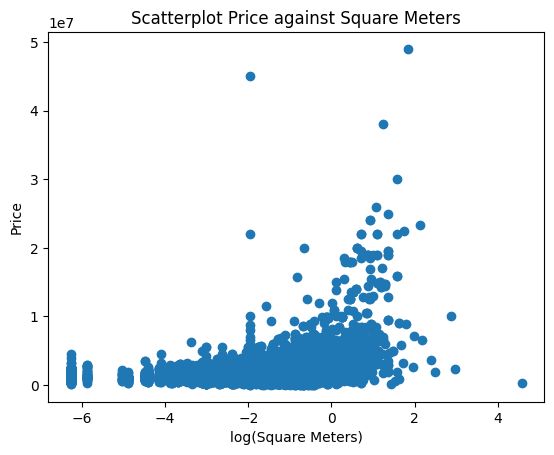

In [40]:
plt.scatter(np.log(np.abs(X_train_preprocessed[:,1])),y_train)
plt.title('Scatterplot Price against Square Meters')
plt.xlabel('log(Square Meters)')
plt.ylabel('Price')

Text(0, 0.5, 'log(Price)')

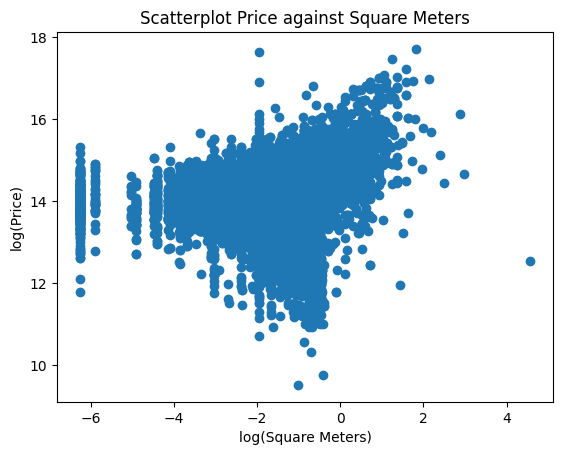

In [41]:
plt.scatter(np.log(np.abs(X_train_preprocessed[:,1])),np.log(y_train))
plt.title('Scatterplot Price against Square Meters')
plt.xlabel('log(Square Meters)')
plt.ylabel('log(Price)')

In [42]:
## Linear Regression pipeline
pipeline_Linear_Regression = Pipeline(steps = [
    #('selector',SelectKBest(mutual_info_regression)),
    ('model',LinearRegression())
    ])

## fit final model
pipeline_Linear_Regression.fit(
    X = np.log(np.abs(X_train_preprocessed[:,1].reshape(-1,1))),
    y = y_train
)

MAPE_Linear_Regression_train = 100 * mean_absolute_percentage_error(y_true = y_train, y_pred = pipeline_Linear_Regression.predict(X = np.log(np.abs(X_train_preprocessed[:,1].reshape(-1,1)))))
MAPE_Linear_Regression_test = 100 * mean_absolute_percentage_error(y_true = y_test, y_pred = pipeline_Linear_Regression.predict(X = np.log(np.abs(X_test_preprocessed[:,1].reshape(-1,1)))))

## output scores:
print(f"""
MAPE train: {MAPE_Linear_Regression_train}
MAPE test: {MAPE_Linear_Regression_test}
""")


MAPE train: 128.1742917745589
MAPE test: 134.72870444105482



Der MAPE und die Verteilung der Residuals haben sich etwas verbessert im Vergleich zu dem Model mit den nicht Transformierten Variablen. Jedoch wird aus der Betrachtung der Scatterplots weiter oben klar, dass ein lineares Modell nicht gut für die vorliegenden Daten geeignet ist.

Zur Verbesserung des MAPE muss das Model Komplexer werden (z.B: weitere Features), oder ein anderes Model gewählt werden, welches besser auf die vorliegenden Daten passt.

In [43]:
## Linear Regression pipeline
pipeline_Linear_Regression = Pipeline(steps = [
    #('selector',SelectKBest(mutual_info_regression)),
    ('model',LinearRegression())
    ])

## fit final model
pipeline_Linear_Regression.fit(
    X = np.log(np.abs(X_train_preprocessed[:,1].reshape(-1,1))),
    y = np.log(y_train)
)

MAPE_Linear_Regression_train = 100 * mean_absolute_percentage_error(y_true = y_train, y_pred = np.exp(pipeline_Linear_Regression.predict(X = np.log(np.abs(X_train_preprocessed[:,1].reshape(-1,1))))))
MAPE_Linear_Regression_test = 100 * mean_absolute_percentage_error(y_true = y_test, y_pred = np.exp(pipeline_Linear_Regression.predict(X = np.log(np.abs(X_test_preprocessed[:,1].reshape(-1,1))))))

## output scores:
print(f"""
MAPE train: {MAPE_Linear_Regression_train}
MAPE test: {MAPE_Linear_Regression_test}
""")




MAPE train: 72.37134728852531
MAPE test: 76.11215145818282



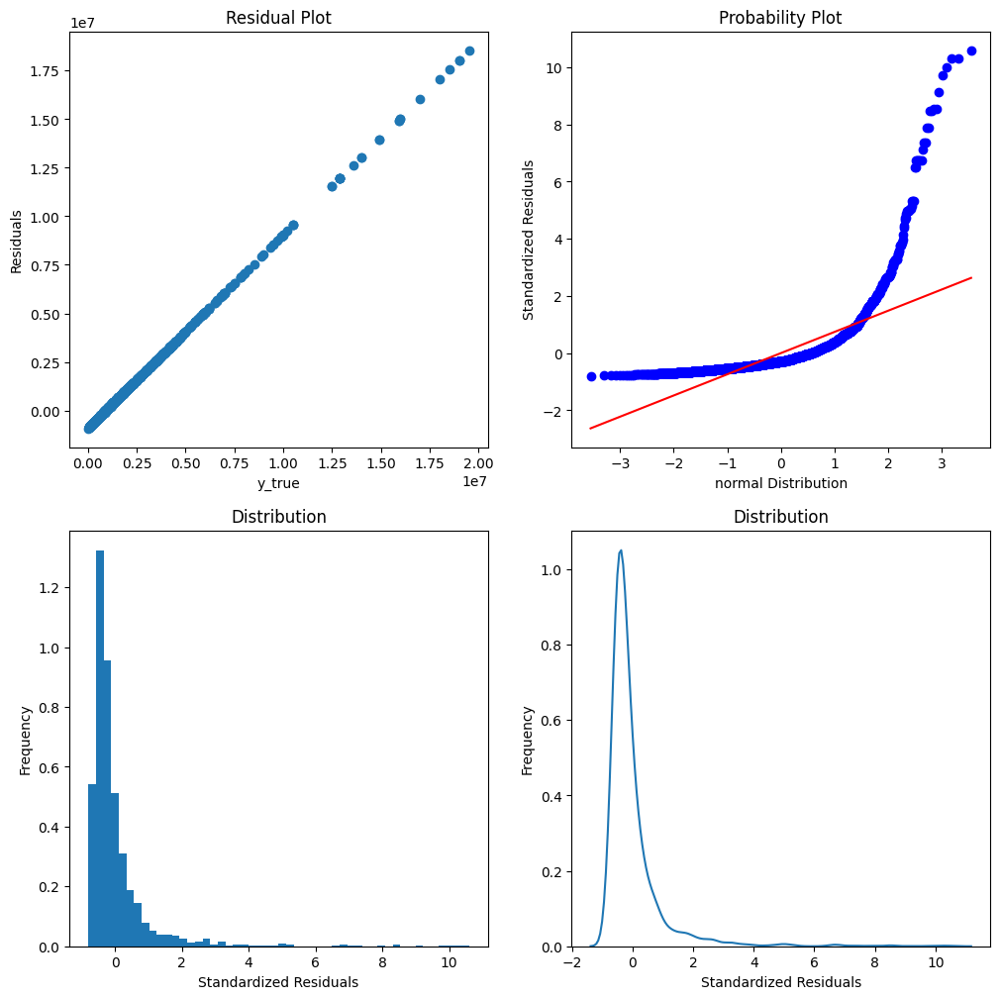

In [44]:
ResidualAnalysisPlot(
    y_true = y_test,
    y_pred = np.exp(pipeline_Linear_Regression.predict(X = np.log(np.abs(X_test_preprocessed[:,1].reshape(-1,1)))))
)

## 8.) Weitere Regressionsmodelle / Teilaufgabe 2.2

### 8.1.) Elastic Net

Beste parameter für das Elastic Net modell:

- k = 30
- alpha = 0.9

In [45]:
# Best param model
pipeline_ElasticNet = Pipeline(steps = [
     ('selector',SelectKBest(mutual_info_regression)),
     ('model',ElasticNet())
    ])

pipeline_ElasticNet.set_params(selector__k = 30, model__alpha = 0.9)

pipeline_ElasticNet.fit(X_train_preprocessed_poly, y_train)
y_pred_elastic = pipeline_ElasticNet.predict(X_test_preprocessed_poly)
mapeElasticNetTrain = 100 * mean_absolute_percentage_error(y_train, pipeline_ElasticNet.predict(X_train_preprocessed_poly))
mapeElasticNetTest = 100 * mean_absolute_percentage_error(y_test, y_pred_elastic)

print(f"MAPE train: {mapeElasticNetTrain:.2f}%")
print(f"MAPE test: {mapeElasticNetTest:.2f}%")

MAPE train: 81.20%
MAPE test: 84.55%


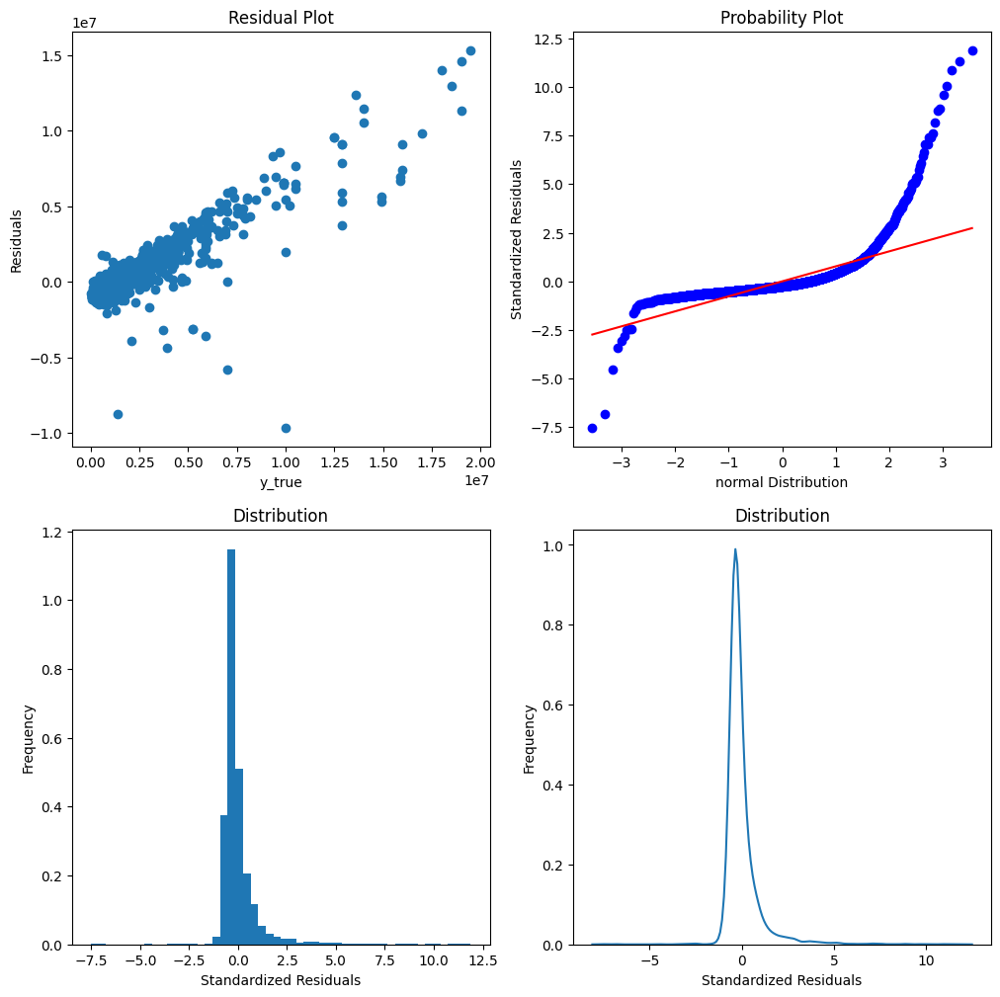

In [46]:
ResidualAnalysisPlot(
    y_true= y_test ,
    y_pred= y_pred_elastic
)

Code zur Optimierung:
```python
## Elastic Net pipeline
pipeline_ElasticNet = Pipeline(steps = [
     ('selector',SelectKBest(mutual_info_regression)),
     ('model',ElasticNet())
    ])

## hyperparameter tuning
search = GridSearchCV(
    estimator = pipeline_ElasticNet,
    param_grid = {
        'selector__k':[10, 30, 90, 180],
        'model__alpha':[0.1, 0.3, 0.9],
        'model__l1_ratio': [0.1, 0.3, 0.5, 0.7, 0.9]
        },
    n_jobs=-1,
    scoring="neg_mean_squared_error",
    cv=5,
    verbose=1
)

## fit best params
search.fit(
    X = X_train_preprocessed[:3000,:],
    y = y_train[:3000]
)

best_params_Elastic = search.best_params_
print(best_params_Elastic)

## set best params
pipeline_ElasticNet.set_params(**best_params_Elastic)

## fit final model
pipeline_ElasticNet.fit(
    X = X_train_preprocessed,
    y = y_train
)

## output scores:
print(f"""
r2 train: {pipeline_ElasticNet.score(X = X_train_preprocessed, y = y_train)}
r2 test: {pipeline_ElasticNet.score(X = X_test_preprocessed, y = y_test)}
""")

## Save the model with numpy
np.save('./data/ElasticNet.npy', pipeline_ElasticNet)
```

### 8.2.) Logistic Regression

Beste parameter für Logistische Regression:

- k = 90
- C = 1

In [47]:
# Best param model
pipeline_Logistic = Pipeline(steps = [
     ('selector',SelectKBest(mutual_info_regression)),
     ('model',LogisticRegression())
    ])

pipeline_Logistic.set_params(selector__k = 90, model__C = 1)

pipeline_Logistic.fit(X_train_preprocessed_poly, y_train)
y_pred_logistic = pipeline_Logistic.predict(X_test_preprocessed_poly)
mapeLogisticTrain = 100 * mean_absolute_percentage_error(y_train, pipeline_Logistic.predict(X_train_preprocessed_poly))
mapeLogisticTest = 100 * mean_absolute_percentage_error(y_test, y_pred_logistic)

print(f"MAPE train: {mapeLogisticTrain:.2f}%")
print(f"MAPE test: {mapeLogisticTest:.2f}%")

c:\Users\rami0\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


MAPE train: 38.77%
MAPE test: 42.95%


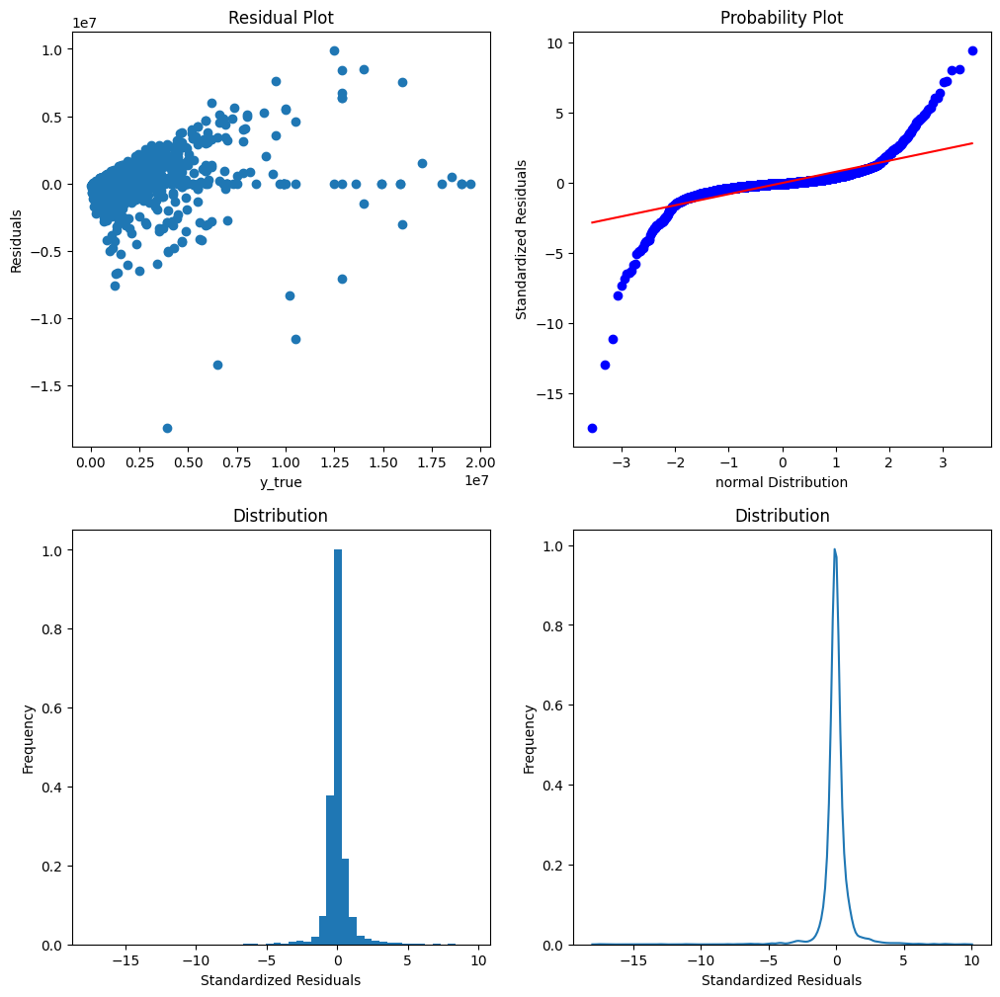

In [48]:
ResidualAnalysisPlot(
    y_true= y_test ,
    y_pred= y_pred_logistic
)

Code zur Optimierung:
```python
## Logistic reg pipeline
pipeline_Logistic = Pipeline(steps = [
     ('selector',SelectKBest(mutual_info_regression)),
     ('model',LogisticRegression())
    ])

## hyperparameter tuning
search = GridSearchCV(
    estimator = pipeline_Logistic,
    param_grid = {
        'selector__k':[10, 30, 90, 180],
        'model__C': [0.1, 1, 10], 
        'model__penalty': ['l1', 'l2']
        },
    n_jobs=-1,
    scoring="neg_mean_squared_error",
    cv=5,
    verbose=3
)

## fit best params
search.fit(
    X = X_train_preprocessed[:3000,:],
    y = y_train[:3000]
)

best_params_Logistic = search.best_params_
print(best_params_Logistic)

## set best params
pipeline_Logistic.set_params(**best_params_Logistic)

## fit final model
pipeline_Logistic.fit(
    X = X_train_preprocessed,
    y = y_train
)

## output scores:
print(f"""
r2 train: {pipeline_Logistic.score(X = X_train_preprocessed, y = y_train)}
r2 test: {pipeline_Logistic.score(X = X_test_preprocessed, y = y_test)}
""")

## Save the model with numpy
np.save('./data/Logistic.npy', pipeline_Logistic)
```

### 8.3.) KNN Regressor

Beste parameter für den KNN Regressor:

- k = 180
- weights = distance

In [49]:
# Best param model
pipeline_KNN = Pipeline(steps = [
     ('selector',SelectKBest(mutual_info_regression)),
     ('model',KNeighborsRegressor())
    ])

pipeline_KNN.set_params(selector__k = 180, model__weights = 'distance')

pipeline_KNN.fit(X_train_preprocessed_poly, y_train)
y_pred_knn = pipeline_KNN.predict(X_test_preprocessed_poly)
mapeKNNTrain = 100 * mean_absolute_percentage_error(y_train, pipeline_KNN.predict(X_train_preprocessed_poly))
mapeKNNTest = 100 * mean_absolute_percentage_error(y_test, y_pred_knn)

print(f"MAPE train: {mapeKNNTrain:.2f}%")
print(f"MAPE test: {mapeKNNTest:.2f}%")

MAPE train: 0.71%
MAPE test: 32.74%


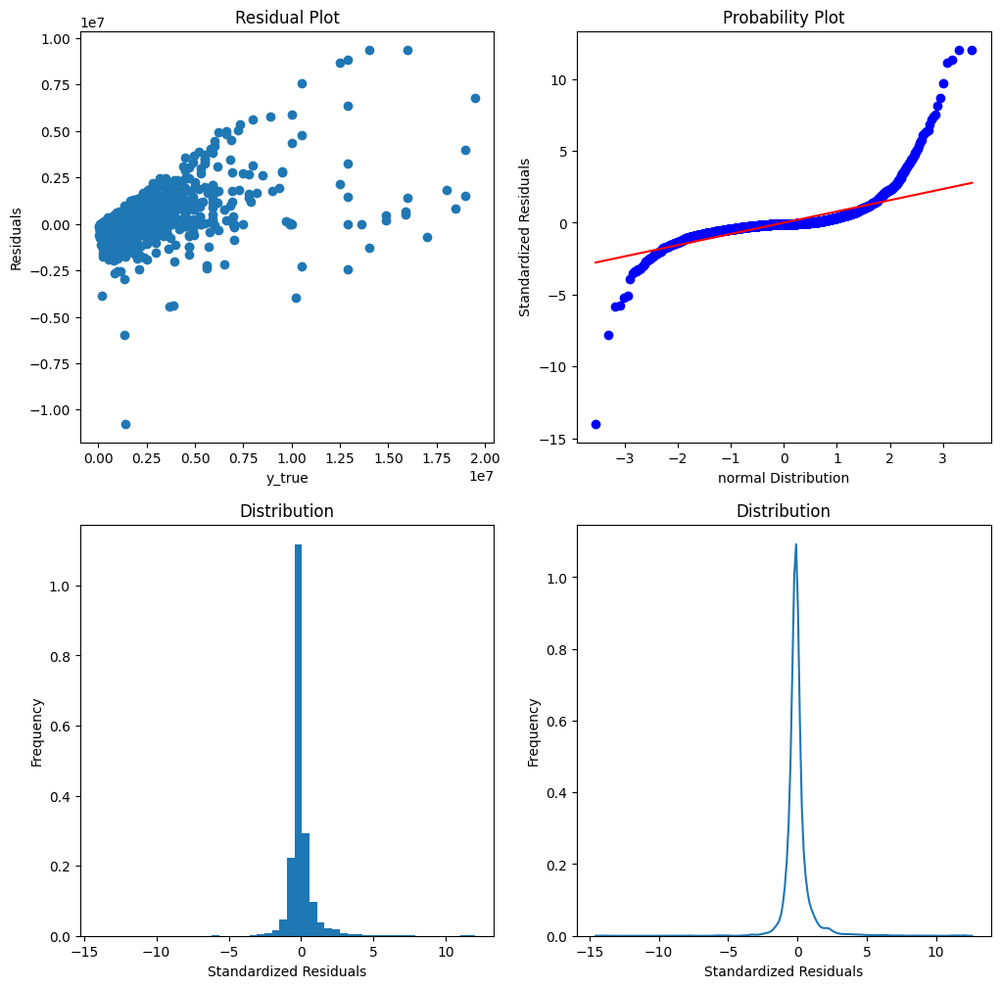

In [50]:
ResidualAnalysisPlot(
    y_true= y_test ,
    y_pred= y_pred_knn
)

Code zur Optimierung:
```python
## KNN pipeline
pipeline_KNN = Pipeline(steps = [
     ('selector',SelectKBest(mutual_info_regression)),
     ('model',KNeighborsRegressor())
    ])

## hyperparameter tuning
search = GridSearchCV(
    estimator = pipeline_KNN,
    param_grid = {
        'selector__k':[10, 30, 90, 180],
        'model__n_neighbors': [5, 7, 8, 9, 10],
        'model__weights': ['uniform', 'distance']
        },
    n_jobs=-1,
    scoring="neg_mean_squared_error",
    cv=5,
    verbose=3
)

## fit best params
search.fit(
    X = X_train_preprocessed[:3000,:],
    y = y_train[:3000]
)

best_params_KNN = search.best_params_
print(best_params_KNN)

## set best params
pipeline_KNN.set_params(**best_params_KNN)

## fit final model
pipeline_KNN.fit(
    X = X_train_preprocessed,
    y = y_train
)

## output scores:
print(f"""
r2 train: {pipeline_KNN.score(X = X_train_preprocessed, y = y_train)}
r2 test: {pipeline_KNN.score(X = X_test_preprocessed, y = y_test)}
""")

## Save the model with numpy
np.save('./data/KNN.npy', pipeline_KNN)
```

### 8.4.) Decision Tree

Beste parameter für den Decision Tree Regressor:

- k = 180
- max depth = 15
- min samples leaf = 4

In [51]:
# Best param model
pipeline_DecisionTree = Pipeline(steps = [
     ('selector',SelectKBest(mutual_info_regression)),
     ('model',DecisionTreeRegressor())
    ])

pipeline_DecisionTree.set_params(selector__k = 180, model__max_depth = 15, model__min_samples_leaf = 4)

pipeline_DecisionTree.fit(X_train_preprocessed_poly, y_train)
y_pred_decisionTree = pipeline_DecisionTree.predict(X_test_preprocessed_poly)
mapeDecisionTreeTrain = 100 * mean_absolute_percentage_error(y_train, pipeline_DecisionTree.predict(X_train_preprocessed_poly))
mapeDecisionTreeTest = 100 * mean_absolute_percentage_error(y_test, y_pred_decisionTree)

print(f"MAPE train: {mapeDecisionTreeTrain:.2f}%")
print(f"MAPE test: {mapeDecisionTreeTest:.2f}%")

MAPE train: 24.92%
MAPE test: 36.87%


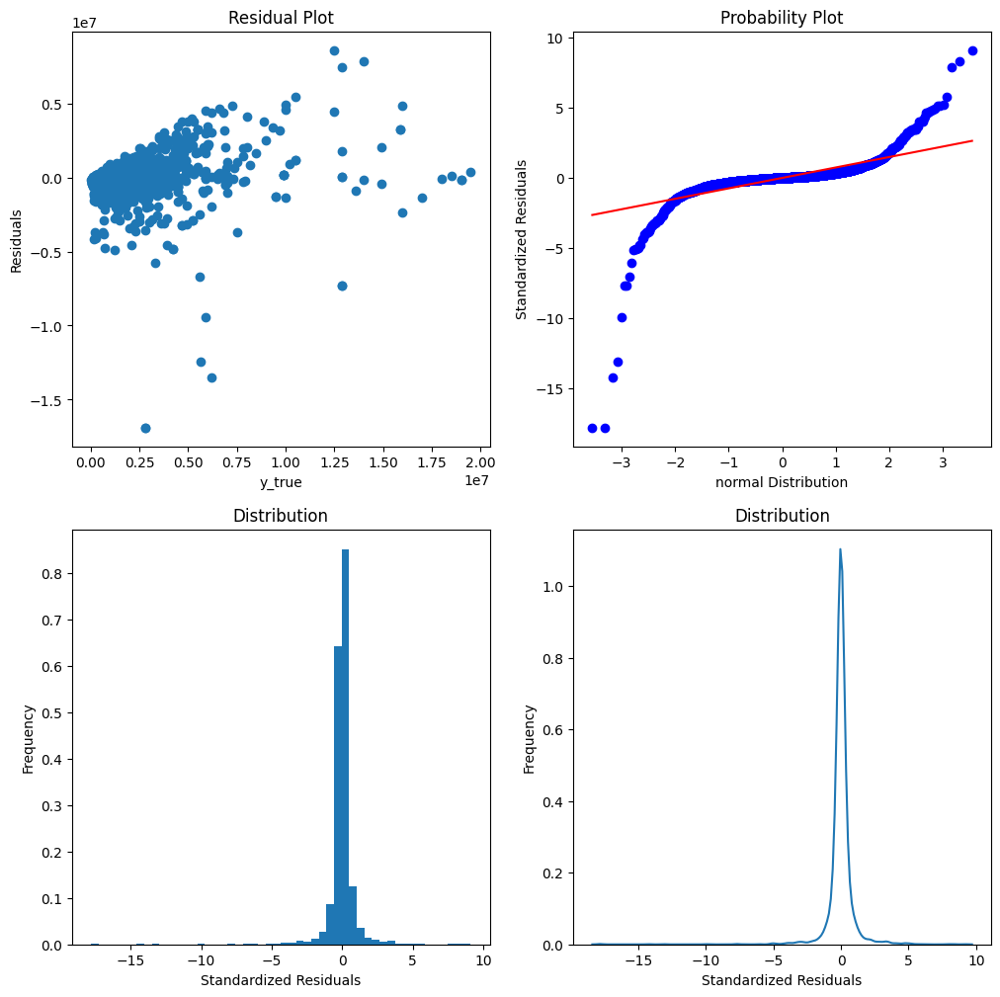

In [52]:
ResidualAnalysisPlot(
    y_true= y_test ,
    y_pred= y_pred_decisionTree
)

Code zur Optimierung:
```python
## Decision Tree pipeline
pipeline_DecisionTree = Pipeline(steps = [
     ('selector',SelectKBest(mutual_info_regression)),
     ('model',DecisionTreeRegressor())
    ])

## hyperparameter tuning
search = GridSearchCV(
    estimator = pipeline_DecisionTree,
    param_grid = {
        'selector__k':[10, 30, 90, 180],
        'model__max_depth': [9,12,15],
        'model__min_samples_split': [2, 4, 8],
        'model__min_samples_leaf': [1, 2, 4]
        },
    n_jobs=-1,
    scoring="neg_mean_squared_error",
    cv=5,
    verbose=3
)

## fit best params
search.fit(
    X = X_train_preprocessed[:3000,:],
    y = y_train[:3000]
)

best_params_DecisionTree = search.best_params_
print(best_params_DecisionTree)

## set best params
pipeline_DecisionTree.set_params(**best_params_DecisionTree)

## fit final model
pipeline_DecisionTree.fit(
    X = X_train_preprocessed,
    y = y_train
)

## output scores:
print(f"""
r2 train: {pipeline_DecisionTree.score(X = X_train_preprocessed, y = y_train)}
r2 test: {pipeline_DecisionTree.score(X = X_test_preprocessed, y = y_test)}
""")

## Save the model with numpy
np.save('./data/DecisionTree.npy', pipeline_DecisionTree)
```

### 8.5.) Random Forest

Beste parameter für den Random Forest Regressor:

- k = 180
- max depth = 15
- max features = 'sqrt'
- min samples leaf = 4

In [53]:
# Best param model
pipeline_RandomForest = Pipeline(steps = [
     ('selector',SelectKBest(mutual_info_regression)),
     ('model',RandomForestRegressor())
    ])

pipeline_RandomForest.set_params(selector__k = 180, model__max_depth = 15, model__max_features='sqrt', model__min_samples_leaf = 4)

pipeline_RandomForest.fit(X_train_preprocessed_poly, y_train)

y_pred_randomForest = pipeline_RandomForest.predict(X_test_preprocessed_poly)
mapeRandomForestTrain = 100 * mean_absolute_percentage_error(y_train, pipeline_RandomForest.predict(X_train_preprocessed_poly))
mapeRandomForestTest = 100 * mean_absolute_percentage_error(y_test, y_pred_randomForest)

print(f"MAPE train: {mapeRandomForestTrain:.2f}%")
print(f"MAPE test: {mapeRandomForestTest:.2f}%")

MAPE train: 28.52%
MAPE test: 37.76%


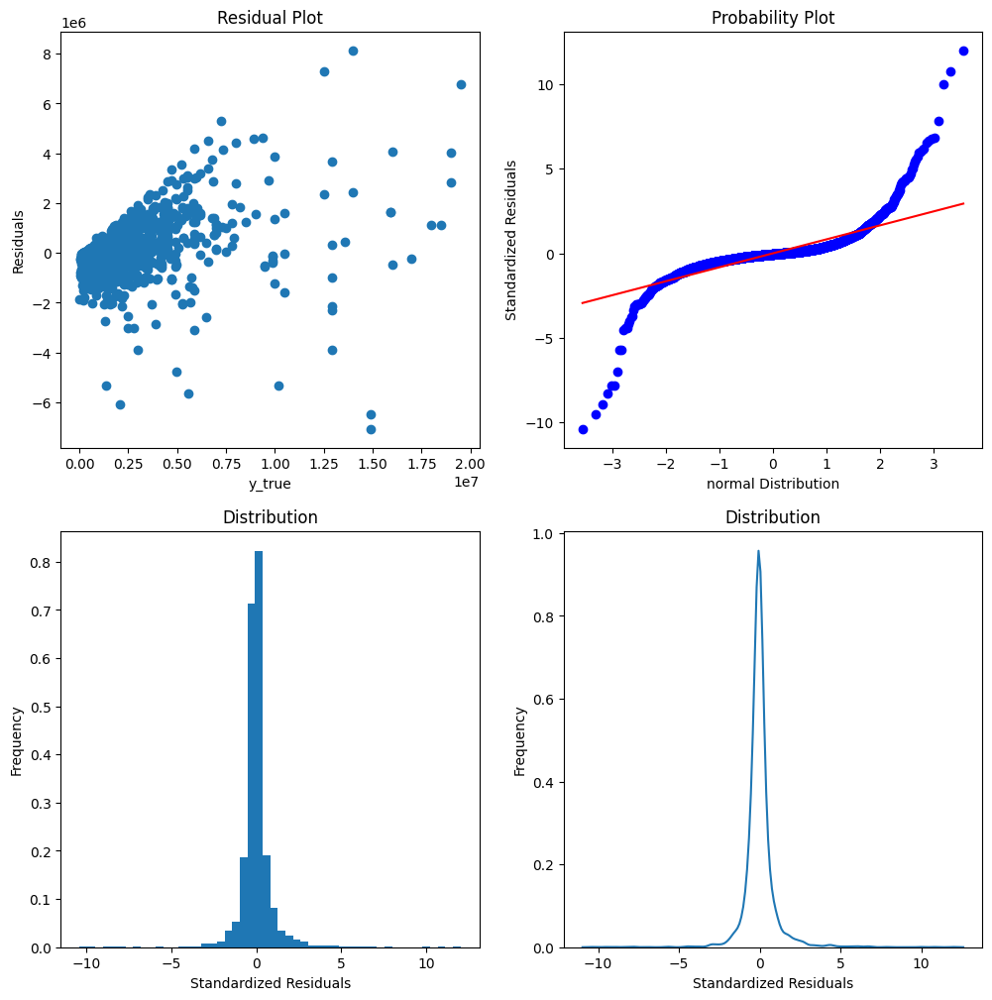

In [54]:
ResidualAnalysisPlot(
    y_true= y_test ,
    y_pred= y_pred_randomForest
)

Code zur Optimierung:
```python
## Random Forest pipleine
pipeline_RandomForest = Pipeline(steps = [
     ('selector',SelectKBest(mutual_info_regression)),
     ('model',RandomForestRegressor())
    ])

## hyperparameter tuning
search = GridSearchCV(
    estimator = pipeline_RandomForest,
    param_grid = {
        'selector__k':[10, 30, 90, 180],
        'model__n_estimators': [100, 200, 300],
        'model__max_depth': [9, 12, 15],
        'model__min_samples_split': [2, 4, 8],
        'model__min_samples_leaf': [1, 2, 4],
        'model__max_features': ['auto', 'sqrt', 'log2']
        },
    n_jobs=-1,
    scoring="neg_mean_squared_error",
    cv=5,
    verbose=3
)

## fit best params
search.fit(
    X = X_train_preprocessed_reduced[:100,:],
    y = y_train[:100]
)

best_params_RandomForest = search.best_params_
print(best_params_RandomForest)

## set best params
pipeline_RandomForest.set_params(**best_params_RandomForest)

## fit final model
pipeline_RandomForest.fit(
    X = X_train_preprocessed_reduced,
    y = y_train
)

## output scores:
print(f"""
r2 train: {pipeline_RandomForest.score(X = X_train_preprocessed_reduced, y = y_train)}
r2 test: {pipeline_RandomForest.score(X = X_test_preprocessed_reduced, y = y_test)}
""")

## Save the model with numpy
np.save('./data/RandomForest.npy', pipeline_RandomForest)
```

### 8.6.) Gradient Boosting - Feature Selection with Mutual Information Selection (without Polynomial Features)

Für das folgende Model haben wir den GradientBoosting Algorithmus von sklearn auf unsere Daten Traniert. Dazu haben wir in der Model Pipeline einfach nur das GradientBoosting Modell integriert. Den Feature_Selector haben wir nicht integriert, da das Model im Hintergrund mit DecisionTrees arbeitet, welche automatisch eine Feature Selection durchführen.



Das Modell ist ein ensemble Modell von der sklearn libary, und funktioniert wie foglt:

1.  Das Modell erstellt ein "Initial Guess" für alle Theta Values. Diese werden initialisiert mit den Mean Values.
2.  Es werden die Resiudals vom Inital guess als pseudo-Residuals gespeichert
3.  Das Modell traniert einen Decision Tree welcher versucht die (pseudo-Residuals) vom inital guess hervorzusagen.
4.  Es werden immer wie weitere Modelle aufgrund der Fehler (pseudo-Residuals) der vorherigen Modelle traniert, bis ein endkriterium erreicht wurde, oder die Maximale Anzahl der Modelle erreicht wurde.
5. Die Predictions werden am Schluss aus der Summer des Inital Guess und aller predicteten pseudo-Residuals erzeugt.

Es ist ein relativ weit verbreiteter Algorithmus, weil er für viele verschiedene Probleme eingesetzt werden kann.

Für uns ist es mit einem MAPE von 28.52 das beste Regressionsmodel

In [55]:
## elastic net pipeline
pipeline_GradientBoosting = Pipeline(steps = [
    #('selector',SelectKBest(mutual_info_regression)),
    ('model',GradientBoostingRegressor(
        #learning_rate = 0.01
    ))
])

## hyperparameter tuning
search = GridSearchCV(
    estimator = pipeline_GradientBoosting,
    param_grid = {
            #'selector__k':[30, 60, 90],
            'model__n_estimators': [60, 90, 120, 150],
            'model__max_depth': [3, 6, 9],
            'model__min_samples_leaf': [1, 3, 5],
            #'model__max_features': [],
            #'model__subsample': [1,2,3],
            #'model__loss': [],
        },
    n_jobs=-1,
    scoring=make_scorer(mean_absolute_percentage_error, greater_is_better = False),
    cv=5,
    verbose=3
)

## fit best params
search.fit(
    #X = X_train_preprocessed[:3000,:],
    #y = y_train[:3000]
    X = X_train_preprocessed,
    y = y_train
)

best_params_GradientBoosting = search.best_params_
print(best_params_GradientBoosting)

## set best params
pipeline_GradientBoosting.set_params(**best_params_GradientBoosting)

## fit final model
pipeline_GradientBoosting.fit(
    X = X_train_preprocessed,
    y = y_train
)

## output scores:
print(f"""
MAPE train: {100 * mean_absolute_percentage_error(y_true = y_train, y_pred = pipeline_GradientBoosting.predict(X = X_train_preprocessed))}
MAPE test: {100 * mean_absolute_percentage_error(y_true = y_test, y_pred = pipeline_GradientBoosting.predict(X = X_test_preprocessed))}
""")

## output predictions
y_pred_GraidentBoosting = pipeline_GradientBoosting.predict(X_contest_preprocessed)

# ouput csv
# y_pred_GradientBoosting_csv = pd.DataFrame(np.column_stack([kaggle_contest.Unnamed_0.values, y_pred_GraidentBoosting]))
y_pred_GradientBoosting_csv = pd.DataFrame(np.column_stack([kaggle_contest['Unnamed_0.1'].values, y_pred_GraidentBoosting]))
y_pred_GradientBoosting_csv.columns = ['Id', 'Expected']
y_pred_GradientBoosting_csv = y_pred_GradientBoosting_csv.set_index('Id')
y_pred_GradientBoosting_csv.to_csv('./data/GradientBoosting_MutualInformation_WithoutPoly_Predictions.csv')

Fitting 5 folds for each of 36 candidates, totalling 180 fits
{'model__max_depth': 9, 'model__min_samples_leaf': 1, 'model__n_estimators': 150}

MAPE train: 13.781684965500107
MAPE test: 28.87439438263531



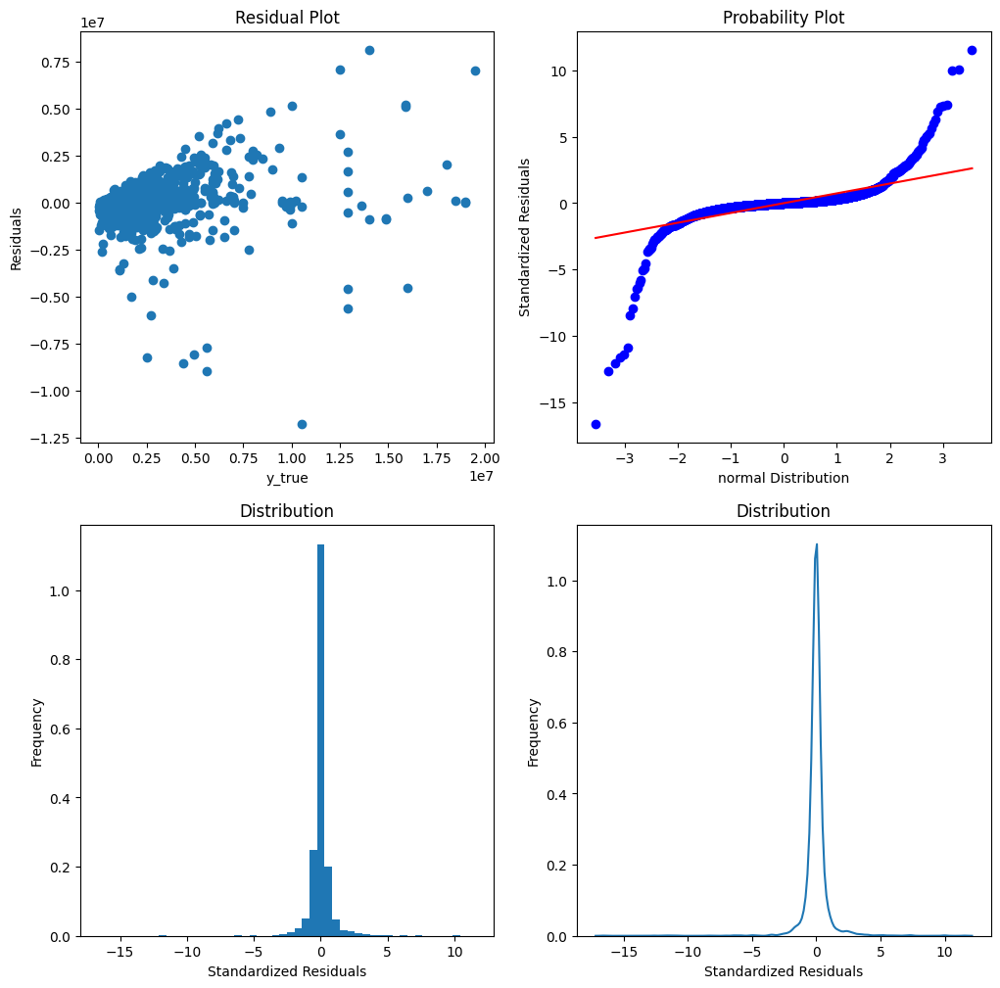

In [56]:
ResidualAnalysisPlot(
    y_true = y_test,
    y_pred = pipeline_GradientBoosting.predict(X = X_test_preprocessed)
)

Aufgrund der Feature Importance vom Modell kann erklärt werden, dass das Feature welches mit Abstand am meisten Einfluss auf den Preis hat, das Feature Living Area ist. Mit einem Wert von ca. 0.48, dies war unserer Meinung auch anzunehmen, weil Wohungspreise aus eigener Erfahrung oftmals von der Wohnungsgrösse abhängen.

Weitere Faktoren, welche wir nicht im Dataset hatten, aber gemäss unserer Erfahrung auch einen grossen Einfluss auf die Wohnungspreise haben:

- Wie modern die Küche ist
- Wie modern das Bad ist
- Design der Wohnung (Laminat/Parkett, Betonwände/Gipswände, etc.)

c:\Users\rami0\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


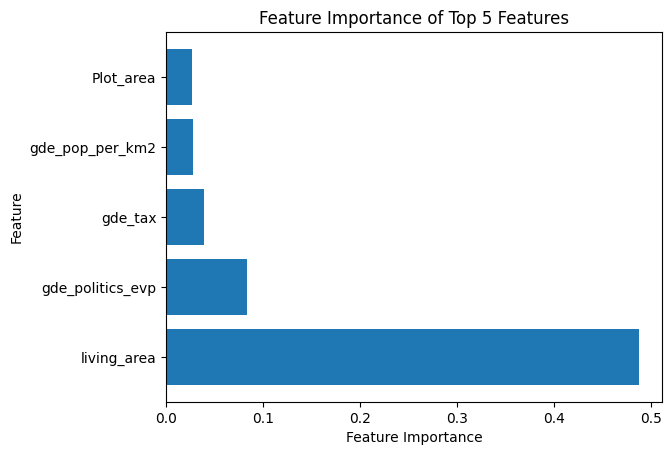

In [57]:
# extract importances from model
importances = pipeline_GradientBoosting.named_steps['model'].feature_importances_

# get feature names:
features_cat = preprocessing_pipeline.named_steps['ColumnTransformer'].named_transformers_['categorical'].named_steps['onehot'].get_feature_names(categorical_features_kaggle)
features_num = np.array(numeric_features_kaggle)
feature_names = np.concatenate([features_num, features_cat])

# sort based on importance
feature_names_sorted = feature_names[np.argsort(-importances)]
importances_sorted = importances[np.argsort(-importances, )]

# Plot the feature importances
plt.barh(range(len(feature_names_sorted[:5])), importances_sorted[:5])
plt.yticks(range(len(feature_names_sorted[:5])), feature_names_sorted[:5])
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Feature Importance of Top 5 Features')
plt.show()

## 9.) Reduzierten Classifier und Regressions modelle / Teilaufgabe 3

Da der Classifier nicht Teil der Kaggle Competition ist, verwenden wir nicht denselben Preprocessed Datensatz. Stattdessen wird ein reduzierter Datensatz auf die Features: Fläche, Zimmer, Jahr, PLZ und Preis, angewendet da dies die Merkmale sind, die wir von den Nutzereingaben über unsere API erhalten werden.

### 9.1.) Daten vorbereitung

Um die Daten für unsere kleine modelle vorbereiten, erstellen wir zwie reduzierte Pipelines, die auf unsere Zielvariablen angepasst sind. Wir erstellen und speichern zwei weil es zwischen dem Regressions und Classifier modelle verschiedene Vorhersagevariablen ja gibt. Aber im Allgemeinen ist die Bereinigungspipeline die gleiche wie die Pipeline des Kaggle-Wettbewerbs

In [58]:
numeric_features_reduced = ['living_area', 'rooms_combined', 'Year_built']

numeric_features_reduced_cls = ['living_area', 'rooms_combined', 'Year_built', 'price']

categorical_features_reduced = ['Type', 'plz']

categorical_features_reduced_cls = ['plz']

In [59]:
class ImproveLivinAreaReduced(BaseEstimator, TransformerMixin):

    def __init__(self):
        pass
        
    def fit(self, X, y = None):
        return self
    
    # function for merging columns
    def ColumnMerger2(self, row):
        return row.Living_area_unified

    def transform(self, X, y = None):
        # merge columns
        X['living_area'] = X.apply(self.ColumnMerger2, axis=1)
        
        return X

class ImproveRoomsReduced(BaseEstimator, TransformerMixin):
    # initializer 
    def __init__(self):
        pass
        
    def fit(self, X, y = None):
        return self

    # function for merging the columns
    def ColumnMerger(self, row):
        return row.rooms

    def transform(self, X, y = None):

        X.rooms = X.rooms.astype(str)
        
        # clean up rooms column and convert to float
        X['rooms'] = (
            X.rooms.str.replace("rm", "")
            .str.replace(",", ".")
            .str.replace(" ", "")
            .astype(float)
        )

        # merge columns into new one
        X['rooms_combined'] = X.apply(self.ColumnMerger, axis=1)

        return X

class FeaturePreselectorReducedRegressor(BaseEstimator, TransformerMixin):
     
    def __init__(self, numeric_features, categorical_features):
        self.numeric_features = numeric_features
        self.categorical_features = categorical_features
        
    def fit(self, X, y = None):
        return self

    def transform(self, X, y = None):
        # reduce dataframe to selected features
        X = pd.concat([X[numeric_features_reduced], X[categorical_features_reduced]], axis=1) 
        return X


class FeaturePreselectorReducedClassifier(BaseEstimator, TransformerMixin):
     
    def __init__(self, numeric_features, categorical_features):
        self.numeric_features = numeric_features
        self.categorical_features = categorical_features
        
    def fit(self, X, y = None):
        return self

    def transform(self, X, y = None):
        # reduce dataframe to selected features
        X = pd.concat([X[numeric_features_reduced_cls], X[categorical_features_reduced_cls]], axis=1)
        return X



In [60]:
CleanupPipelineReduced_regressor = Pipeline(steps=[
    ("ImproveLivinAreaReduced", ImproveLivinAreaReduced()),
    ("ImproveRoomsReduced", ImproveRoomsReduced()),
    ("TypeCleaner", TypeCleaner()),
    ("NumericStripper", NumericStripper(numeric_features_reduced)),
    ("FeaturePreselector", FeaturePreselectorReducedRegressor(numeric_features_reduced , categorical_features_reduced)),
])

CleanupPipelineReduced_classifier = Pipeline(steps=[
    ("ImproveLivinAreaReduced", ImproveLivinAreaReduced()),
    ("ImproveRoomsReduced", ImproveRoomsReduced()),
    ("NumericStripper", NumericStripper(numeric_features_reduced)),
    ("FeaturePreselector", FeaturePreselectorReducedClassifier(numeric_features_reduced_cls , categorical_features_reduced_cls)),
])

In [61]:
# create preprocessing pipeline for numeric data
numeric_transformer_reduced = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy = 'median')),
    ('scaler', StandardScaler()),
    ])

# create preprocessing pipeline for categorical data
categorical_transfromer_reduced = Pipeline(steps=[
    ("imputer", SimpleImputer(strategy="constant", fill_value="missing")),
    ("onehot", OneHotEncoder(handle_unknown='ignore')),
    ])

preprocessing_transformer_reduced_reg = ColumnTransformer([ 
    ("numeric", numeric_transformer_reduced, numeric_features_reduced ),
    ("categorical", categorical_transfromer_reduced, categorical_features_reduced )],
    remainder='passthrough'
    )

preprocessing_transformer_reduced_cls = ColumnTransformer([ 
    ("numeric", numeric_transformer_reduced, numeric_features_reduced_cls ),
    ("categorical", categorical_transfromer_reduced, categorical_features_reduced_cls )],
    remainder='passthrough'
    )

In [62]:
preprocessing_pipeline_reduced_reg = Pipeline(steps=[
    ("Cleaner", CleanupPipelineReduced_regressor),
    ("ColumnTransformer", preprocessing_transformer_reduced_reg),
    ])

preprocessing_pipeline_reduced_cls = Pipeline(steps=[
    ("Cleaner", CleanupPipelineReduced_classifier),
    ("ColumnTransformer", preprocessing_transformer_reduced_cls),
    ])

#### 9.1.1.) Test/Train split regressor

In [63]:
# split target from features
X_reduced_reg = immo.drop(columns=['price'])
y_reduced_reg = immo.price

X_reduced_reg['plz'] = X_reduced_reg['plz'].astype(str)

# train test split
X_train_reduced_reg, X_test_reduced_reg, y_train_reduced_reg, y_test_reduced_reg = train_test_split(X_reduced_reg, y_reduced_reg, test_size= 0.2,random_state =12345)

C:\Users\rami0\AppData\Local\Temp/ipykernel_17048/4162621491.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_reduced_reg['plz'] = X_reduced_reg['plz'].astype(str)


In [64]:
# fit preprocessing pipeline for small regressor model
preprocessing_pipeline_reduced_reg.fit(X_train_reduced_reg)

# transform data
X_train_preprocessed_reduced_reg = preprocessing_pipeline_reduced_reg.transform(X_train_reduced_reg)
X_test_preprocessed_reduced_reg = preprocessing_pipeline_reduced_reg.transform(X_test_reduced_reg)

In [65]:
dump(preprocessing_pipeline_reduced_reg, './preprocessing_pipeline_reduced_reg.joblib')

['./preprocessing_pipeline_reduced_reg.joblib']

#### 9.1.2.) Test/Train split classifier

In [66]:
immoCls = immo.copy()

immoCls = TypeCleaner().fit_transform(immoCls)

immoCls = immoCls[immoCls['type'].map(immoCls['type'].value_counts()) > 5]

In [67]:
# split target from features
X_reduced_cls = immoCls.drop(columns=['Type'])
y_reduced_cls = immoCls.Type

X_reduced_cls['plz'] = X_reduced_cls['plz'].astype(str)

# train test split
X_train_reduced_cls, X_test_reduced_cls, y_train_reduced_cls, y_test_reduced_cls = train_test_split(X_reduced_cls, y_reduced_cls, test_size= 0.2,random_state =12345)

C:\Users\rami0\AppData\Local\Temp/ipykernel_17048/793587284.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_reduced_cls['plz'] = X_reduced_cls['plz'].astype(str)


In [68]:
# fit preprocessing pipeline for small regressor model
preprocessing_pipeline_reduced_cls.fit(X_train_reduced_cls)

# transform data
X_train_preprocessed_reduced_cls = preprocessing_pipeline_reduced_cls.transform(X_train_reduced_cls)
X_test_preprocessed_reduced_cls = preprocessing_pipeline_reduced_cls.transform(X_test_reduced_cls)

In [69]:
dump(preprocessing_pipeline_reduced_cls, './preprocessing_pipeline_reduced_cls.joblib')

['./preprocessing_pipeline_reduced_cls.joblib']

### 9.2.) Classifier modelle

#### 9.2.1.) Random forest

In [70]:
randomForestClsModel = RandomForestClassifier(max_depth=15, min_samples_leaf=4, max_features='sqrt', n_jobs=-1)

randomForestClsModel.fit(X_train_preprocessed_reduced_cls, y_train_reduced_cls)

y_pred_smallClassifierModel = randomForestClsModel.predict(X_test_preprocessed_reduced_cls)

print(classification_report(y_test_reduced_cls, y_pred_smallClassifierModel, zero_division=0))

                                precision    recall  f1-score   support

                    attic-flat       0.00      0.00      0.00        94
                    attic-room       0.00      0.00      0.00         3
                        chalet       1.00      0.03      0.05       119
                detached-house       0.55      0.33      0.41       963
             duplex-maisonette       0.00      0.00      0.00       113
                     farmhouse       0.00      0.00      0.00        28
                          flat       0.53      0.97      0.68      1636
furnished-residential-property       0.00      0.00      0.00         2
                          loft       0.00      0.00      0.00         6
                     penthouse       0.00      0.00      0.00        97
                       rustico       0.00      0.00      0.00        16
           semi-detached-house       0.00      0.00      0.00       151
             stepped-apartment       0.00      0.00      0.00  

#### 9.2.2.) K Neighbours Classifier

In [71]:
knnCls = KNeighborsClassifier(n_neighbors=20, n_jobs=-1, weights='distance')

knnCls.fit(X_train_preprocessed_reduced_cls, y_train_reduced_cls)

y_pred_knnCls = knnCls.predict(X_test_preprocessed_reduced_cls)

print(classification_report(y_test_reduced_cls, y_pred_knnCls, zero_division=0))

                                precision    recall  f1-score   support

                    attic-flat       0.34      0.11      0.16        94
                    attic-room       0.00      0.00      0.00         3
                        chalet       0.51      0.30      0.38       119
                detached-house       0.60      0.68      0.64       963
             duplex-maisonette       0.33      0.08      0.13       113
                     farmhouse       0.25      0.04      0.06        28
                          flat       0.69      0.91      0.79      1636
furnished-residential-property       0.00      0.00      0.00         2
                          loft       1.00      0.17      0.29         6
                     penthouse       0.16      0.04      0.07        97
                       rustico       0.00      0.00      0.00        16
           semi-detached-house       0.49      0.24      0.32       151
             stepped-apartment       0.50      0.10      0.17  

#### 9.2.3.) SVC Classifier

In [72]:
svcCls = SVC(kernel='rbf', C=1, gamma=0.2)

svcCls.fit(X_train_preprocessed_reduced_cls, y_train_reduced_cls)

y_pred_svcCls = svcCls.predict(X_test_preprocessed_reduced_cls)

print(classification_report(y_test_reduced_cls, y_pred_svcCls, zero_division=0))

                                precision    recall  f1-score   support

                    attic-flat       0.00      0.00      0.00        94
                    attic-room       0.00      0.00      0.00         3
                        chalet       0.59      0.32      0.42       119
                detached-house       0.57      0.72      0.63       963
             duplex-maisonette       0.00      0.00      0.00       113
                     farmhouse       0.00      0.00      0.00        28
                          flat       0.66      0.92      0.77      1636
furnished-residential-property       0.00      0.00      0.00         2
                          loft       0.00      0.00      0.00         6
                     penthouse       0.00      0.00      0.00        97
                       rustico       0.00      0.00      0.00        16
           semi-detached-house       0.33      0.01      0.03       151
             stepped-apartment       0.00      0.00      0.00  

#### 9.2.4.) MLP Classifier

In [73]:
from sklearn.neural_network import MLPClassifier

mlpCls = MLPClassifier(hidden_layer_sizes=(96, 128, 34), max_iter=500, tol=1e-9)

mlpCls.fit(X_train_preprocessed_reduced_cls, y_train_reduced_cls)

y_pred_mlpCls = mlpCls.predict(X_test_preprocessed_reduced_cls)

print(classification_report(y_test_reduced_cls, y_pred_mlpCls, zero_division=0))

                                precision    recall  f1-score   support

                    attic-flat       0.22      0.19      0.20        94
                    attic-room       0.50      0.33      0.40         3
                        chalet       0.51      0.48      0.49       119
                detached-house       0.61      0.59      0.60       963
             duplex-maisonette       0.21      0.14      0.17       113
                     farmhouse       0.18      0.14      0.16        28
                          flat       0.73      0.81      0.77      1636
furnished-residential-property       0.00      0.00      0.00         2
                          loft       0.50      0.17      0.25         6
                     penthouse       0.13      0.11      0.12        97
                       rustico       0.07      0.06      0.07        16
           semi-detached-house       0.33      0.28      0.30       151
             stepped-apartment       0.31      0.17      0.22  

#### 9.2.5.) Modell Speichern

Da der k-nearest Neighbors Classifier das kleinste Modell ist und die höchste Genauigkeit aufweist, speichern wir ihn zum Einsatz mit unserer API.

In [74]:
np.save('smallClsModel.npy', knnCls)

### 9.3.) Regressions modell

In [75]:
smallRegModel = KNeighborsRegressor(weights='distance', n_jobs=-1)

smallRegModel.fit(X_train_preprocessed_reduced_reg, y_train_reduced_reg)

y_pred_smallRegModel = smallRegModel.predict(X_test_preprocessed_reduced_reg)

print('R2 score: ', r2_score(y_test_reduced_reg, y_pred_smallRegModel))
print('MAPE: ', mean_absolute_percentage_error(y_test_reduced_reg, y_pred_smallRegModel))

R2 score:  0.679287992518643
MAPE:  0.3902630937568712


#### 9.3.1.) Modell Speichern

In [76]:
np.save('smallRegModel.npy', smallRegModel)

## 10.) API / Teilaufgabe 2.3

Unsere API ist mit FastAPI aufgebaut und verwendet hypercorn als ASGI-Server. Die API hat ein einzigen Route /predictor/, wo wir die gewünschte Vorhersage typ (Preis oder Haustyp) und die eingegebene Features erhalten.

Die features gehen denn durch die preprocessing pipeline, um sie in die richtige Datenstruktur zu bringen, und gehen danach inzu das angeforderte Model. Sobald wir eine Vorhersage haben wird sie an den benutzer zurückgeschickt.

Die features die wir erhalten vom user sind:

- Area
- Raume
- Bau Jahr
- Die postleitzahl
- Haustyp/Preis (hängt vom Vorhersagetyp ab)

Die Vorhersage kommt entweder als:

- Preis, gerundet auf die nächsten 10000
- Haustyp

Den code für die API ist im main.py zu finden.

In [9]:
!jupyter nbconvert Final_Bericht_(1).ipynb --to pdf --no-input --TagRemovePreprocessor.remove_cell_tags='{"remove-cell"}'

c:\users\rami0\anaconda3\lib\site-packages\traitlets\traitlets.py:2547: FutureWarning: Supporting extra quotes around strings is deprecated in traitlets 5.0. You can use 'remove-cell' instead of "'remove-cell'" if you require traitlets >=5.
  warn(
[NbConvertApp] Converting notebook Final_Bericht_(1).ipynb to pdf
[NbConvertApp] Support files will be in Final_Bericht_(1)_files\
[NbConvertApp] Making directory .\Final_Bericht_(1)_files
[NbConvertApp] Making directory .\Final_Bericht_(1)_files
[NbConvertApp] Making directory .\Final_Bericht_(1)_files
[NbConvertApp] Making directory .\Final_Bericht_(1)_files
[NbConvertApp] Making directory .\Final_Bericht_(1)_files
[NbConvertApp] Making directory .\Final_Bericht_(1)_files
[NbConvertApp] Making directory .\Final_Bericht_(1)_files
[NbConvertApp] Making directory .\Final_Bericht_(1)_files
[NbConvertApp] Making directory .\Final_Bericht_(1)_files
[NbConvertApp] Making directory .\Final_Bericht_(1)_files
[NbConvertApp] Making directory .\Final_